In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import math
import networkx as nx
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [2]:
data=pd.read_csv('BankChurners.csv')
data

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1,Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.999910
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.999940
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.999980
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.999870
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.999980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,772366833,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,...,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0.000191,0.999810
10123,710638233,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,...,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0.995270,0.004729
10124,716506083,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,...,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0.997880,0.002118
10125,717406983,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,...,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0.996710,0.003294


In [3]:
import pandas_profiling
profile = pandas_profiling.ProfileReport(data)
profile

Summarize dataset:   0%|          | 0/36 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
profile.to_file('profile.html')

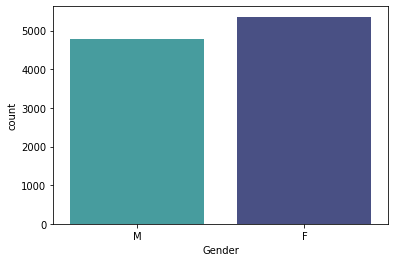

In [4]:
import seaborn as sns
sns.countplot(x='Gender',data=data,palette='mako_r')
plt.xlabel("Gender")
plt.show()

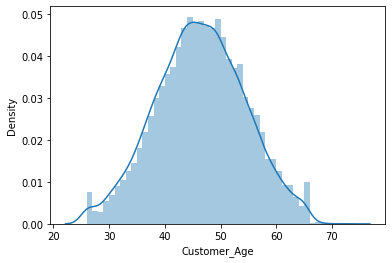

In [5]:
sns.distplot(data['Customer_Age'])
plt.show()

In [6]:
data.info()#无缺失值

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                                                                                                                              Non-Null Count  Dtype  
---  ------                                                                                                                              --------------  -----  
 0   CLIENTNUM                                                                                                                           10127 non-null  int64  
 1   Attrition_Flag                                                                                                                      10127 non-null  object 
 2   Customer_Age                                                                                                                        10127 non-null  int64  
 3   Gender                                                                           

In [7]:
data.drop(columns=['CLIENTNUM'
                   ,'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1'
                   ,'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2']
          ,inplace=True)
data

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,Existing Customer,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,Attrited Customer,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,Attrited Customer,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,Attrited Customer,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [8]:
Attrition_Flag=np.unique(np.array(data.iloc[:,0]))
Attrition_Flag#二分类


array(['Attrited Customer', 'Existing Customer'], dtype=object)

In [9]:
Attrited_Customer=np.where(np.array(data.iloc[:,0])==Attrition_Flag[0])[0]
Existing_Customer=np.where(np.array(data.iloc[:,0])==Attrition_Flag[1])[0]
print(len(Attrited_Customer))
print(len(Existing_Customer))

1627
8500


In [10]:
Attrited_array=np.array(data.iloc[Attrited_Customer,0])
Existing_array=np.array(data.iloc[Existing_Customer,0])
Attrited_array=np.zeros(len(Attrited_array))
Existing_array=np.ones(len(Existing_array))
Existing_array

array([1., 1., 1., ..., 1., 1., 1.])

In [11]:
data.iloc[Attrited_Customer,0]=Attrited_array
data.iloc[Existing_Customer,0]=Existing_array
data#处理label

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,1,45,M,3,High School,Married,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,1,49,F,5,Graduate,Single,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,1,51,M,3,Graduate,Married,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,1,40,F,4,High School,Unknown,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,1,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,1,50,M,2,Graduate,Single,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,0,41,M,2,Unknown,Divorced,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,0,44,F,1,High School,Married,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,0,30,M,2,Graduate,Unknown,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [13]:
# #性别
# from sklearn.preprocessing import OneHotEncoder
# one=OneHotEncoder()
# model=one.fit(np.array(data.iloc[:,2]).reshape(-1,1))#Gender
# Gender = one.transform(np.array(data.iloc[:,2]).reshape(-1,1)).toarray()
# print(Gender)
# print(one.get_feature_names())

In [14]:
# #婚姻
# from sklearn.preprocessing import OneHotEncoder
# marry=OneHotEncoder()
# model=marry.fit(np.array(data.loc[:,'Marital_Status']).reshape(-1,1))
# Marital_Status = marry.transform(np.array(data.loc[:,'Marital_Status']).reshape(-1,1)).toarray()
# print(Marital_Status)
# print(marry.get_feature_names())

In [15]:
# data.drop(columns=['Gender','Marital_Status'],inplace=True)
# data

In [16]:
# data1=pd.concat([pd.DataFrame(Gender,columns=one.get_feature_names()),pd.DataFrame(Marital_Status,columns=marry.get_feature_names())],axis=1)
# data1

In [17]:
# #拼接
# data=pd.concat([data,data1],axis=1)
# data

In [12]:
#性别
data.loc[data['Gender']=='M','Gender']=1
data.loc[data['Gender']=='F','Gender']=0
data
#婚姻
data.loc[data['Marital_Status']=='Unknown','Marital_Status']=0
data.loc[data['Marital_Status']=='Single','Marital_Status']=1
data.loc[data['Marital_Status']=='Divorced','Marital_Status']=2
data.loc[data['Marital_Status']=='Married','Marital_Status']=3
data


,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,1,45,1,3,High School,3,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,1,49,0,5,Graduate,1,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,1,51,1,3,Graduate,3,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,1,40,0,4,High School,0,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,1,40,1,3,Uneducated,3,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,1,50,1,2,Graduate,1,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,0,41,1,2,Unknown,2,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,0,44,0,1,High School,3,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,0,30,1,2,Graduate,0,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [13]:
#学历
Education_Level=data.loc[:,'Education_Level']
Education_Level
np.unique(np.array(Education_Level))

array(['College', 'Doctorate', 'Graduate', 'High School', 'Post-Graduate',
       'Uneducated', 'Unknown'], dtype=object)

In [14]:
#Doctorate=data[data['Education_Level']=='Doctorate']
data.loc[data['Education_Level']=='Doctorate','Education_Level']=7
data.loc[data['Education_Level']=='Post-Graduate','Education_Level']=6
data.loc[data['Education_Level']=='Graduate','Education_Level']=5
data.loc[data['Education_Level']=='College','Education_Level']=4
data.loc[data['Education_Level']=='High School','Education_Level']=3
data.loc[data['Education_Level']=='Uneducated','Education_Level']=2
data.loc[data['Education_Level']=='Unknown','Education_Level']=1
data

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,1,45,1,3,3,3,$60K - $80K,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,1,49,0,5,5,1,Less than $40K,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,1,51,1,3,5,3,$80K - $120K,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,1,40,0,4,3,0,Less than $40K,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,1,40,1,3,2,3,$60K - $80K,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,1,50,1,2,5,1,$40K - $60K,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,0,41,1,2,1,2,$40K - $60K,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,0,44,0,1,3,3,Less than $40K,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,0,30,1,2,5,0,$40K - $60K,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [15]:
#收入
Income_Category=data.loc[:,'Income_Category']
Income_Category
np.unique(np.array(Income_Category))

array(['$120K +', '$40K - $60K', '$60K - $80K', '$80K - $120K',
       'Less than $40K', 'Unknown'], dtype=object)

In [16]:
data.loc[data['Income_Category']=='$120K +','Income_Category']=6
data.loc[data['Income_Category']=='$80K - $120K','Income_Category']=5
data.loc[data['Income_Category']=='$60K - $80K','Income_Category']=4
data.loc[data['Income_Category']=='$40K - $60K','Income_Category']=3
data.loc[data['Income_Category']=='Less than $40K','Income_Category']=2
data.loc[data['Income_Category']=='Unknown','Income_Category']=1
data

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,1,45,1,3,3,3,4,Blue,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,1,49,0,5,5,1,2,Blue,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,1,51,1,3,5,3,5,Blue,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,1,40,0,4,3,0,2,Blue,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,1,40,1,3,2,3,4,Blue,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,1,50,1,2,5,1,3,Blue,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,0,41,1,2,1,2,3,Blue,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,0,44,0,1,3,3,2,Blue,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,0,30,1,2,5,0,3,Blue,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [17]:
#Card_Category
Card_Category=data.loc[:,'Card_Category']
Card_Category
np.unique(np.array(Card_Category))

array(['Blue', 'Gold', 'Platinum', 'Silver'], dtype=object)

In [18]:
data.loc[data['Card_Category']=='Platinum','Card_Category']=4
data.loc[data['Card_Category']=='Gold','Card_Category']=3
data.loc[data['Card_Category']=='Silver','Card_Category']=2
data.loc[data['Card_Category']=='Blue','Card_Category']=1
data

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,1,45,1,3,3,3,4,1,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,1,49,0,5,5,1,2,1,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,1,51,1,3,5,3,5,1,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,1,40,0,4,3,0,2,1,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,1,40,1,3,2,3,4,1,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,1,50,1,2,5,1,3,1,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,0,41,1,2,1,2,3,1,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,0,44,0,1,3,3,2,1,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,0,30,1,2,5,0,3,1,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [19]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  object 
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  object 
 3   Dependent_count           10127 non-null  int64  
 4   Education_Level           10127 non-null  object 
 5   Marital_Status            10127 non-null  object 
 6   Income_Category           10127 non-null  object 
 7   Card_Category             10127 non-null  object 
 8   Months_on_book            10127 non-null  int64  
 9   Total_Relationship_Count  10127 non-null  int64  
 10  Months_Inactive_12_mon    10127 non-null  int64  
 11  Contacts_Count_12_mon     10127 non-null  int64  
 12  Credit_Limit              10127 non-null  float64
 13  Total_Revolving_Bal       10127 non-null  int64  
 14  Avg_Op

In [20]:
#Attrition_Flag  需要转换格式
Attrition_Flag=pd.Series(data.iloc[:,0],dtype=int)
Attrition_Flag
data.iloc[:,0]=Attrition_Flag
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  int32  
 1   Customer_Age              10127 non-null  int64  
 2   Gender                    10127 non-null  object 
 3   Dependent_count           10127 non-null  int64  
 4   Education_Level           10127 non-null  object 
 5   Marital_Status            10127 non-null  object 
 6   Income_Category           10127 non-null  object 
 7   Card_Category             10127 non-null  object 
 8   Months_on_book            10127 non-null  int64  
 9   Total_Relationship_Count  10127 non-null  int64  
 10  Months_Inactive_12_mon    10127 non-null  int64  
 11  Contacts_Count_12_mon     10127 non-null  int64  
 12  Credit_Limit              10127 non-null  float64
 13  Total_Revolving_Bal       10127 non-null  int64  
 14  Avg_Op

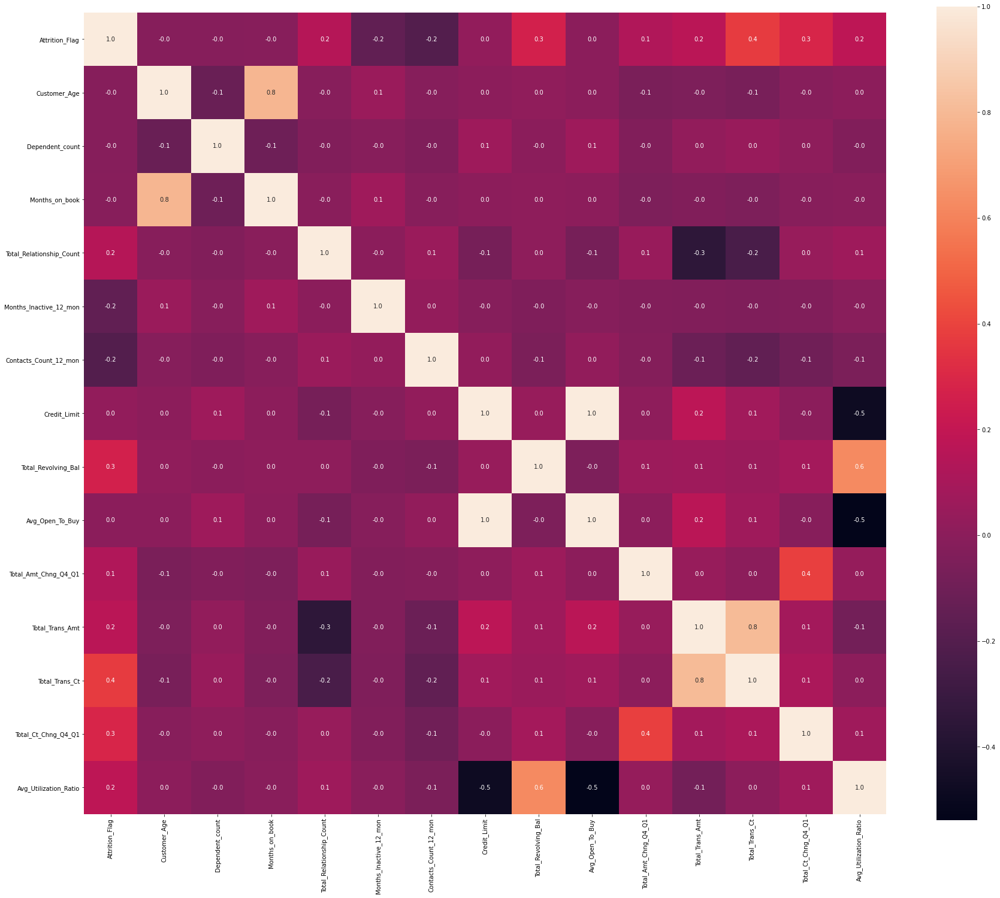

In [21]:
#绘制热力图
import seaborn as sns
#fio_corr=fio_removed.iloc[:,:18].apply(lambda x:x.astype(float))#变为浮点数
plt.figure(figsize=(30,25))
fig=sns.heatmap(data.corr(),annot=True,fmt='.1f',square=True)
plt.show()

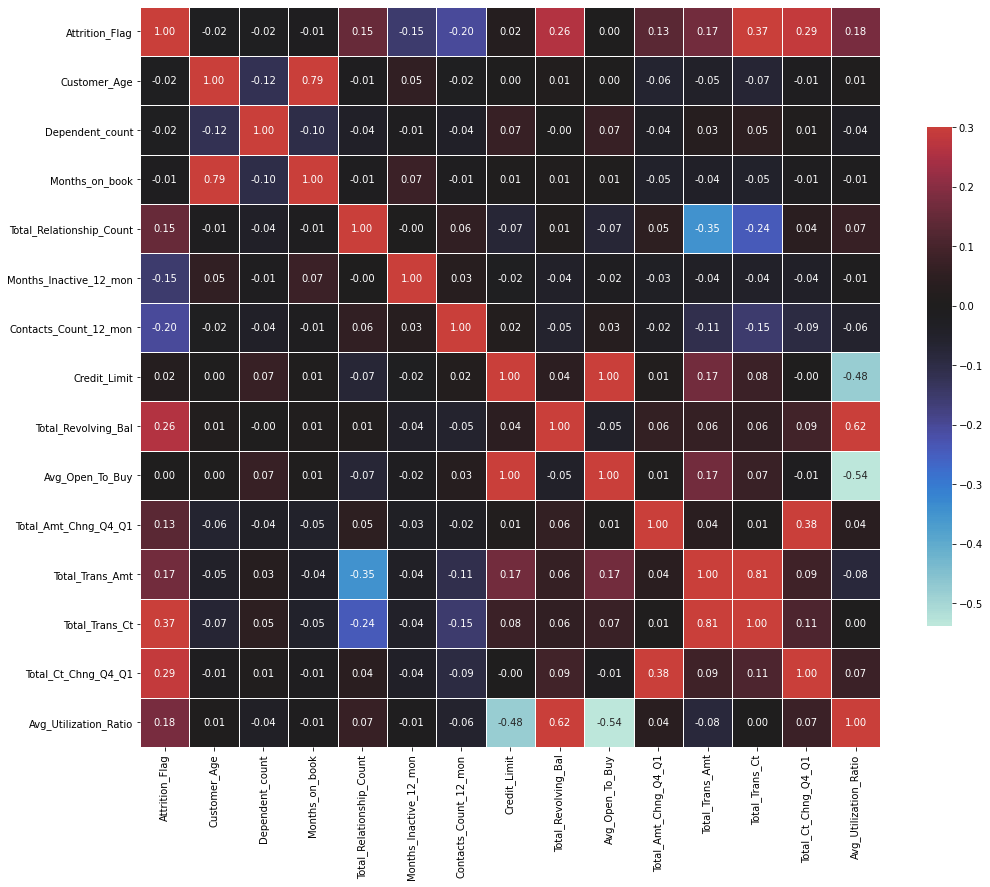

In [22]:
plt.figure(figsize=(15,15))
sns.heatmap(data.corr(),vmax=.3,center=0,square=True,linewidths=.5,cbar_kws={"shrink":.5},annot=True,fmt='.2f')
plt.tight_layout()
plt.show()

In [29]:
# sns.pairplot(data)#各列之间两两的关系
# plt.show()

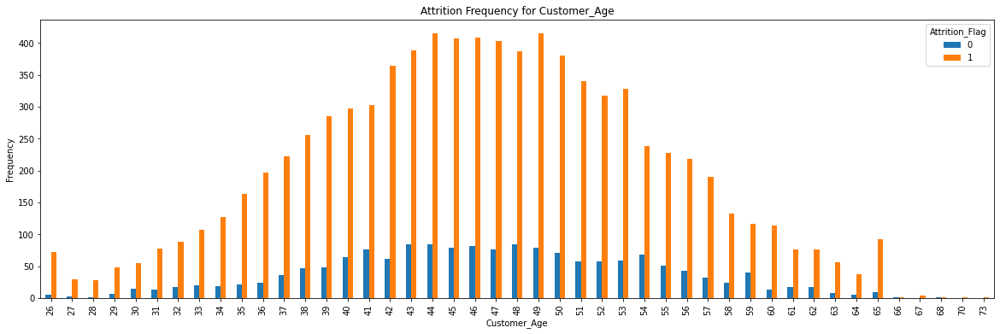

In [23]:
#单列特征与标签的关系
pd.crosstab(data.Customer_Age,data.Attrition_Flag).plot(kind="bar",figsize=(20,6))
plt.title('Attrition Frequency for Customer_Age')
plt.xlabel('Customer_Age')
plt.ylabel('Frequency')
plt.show()

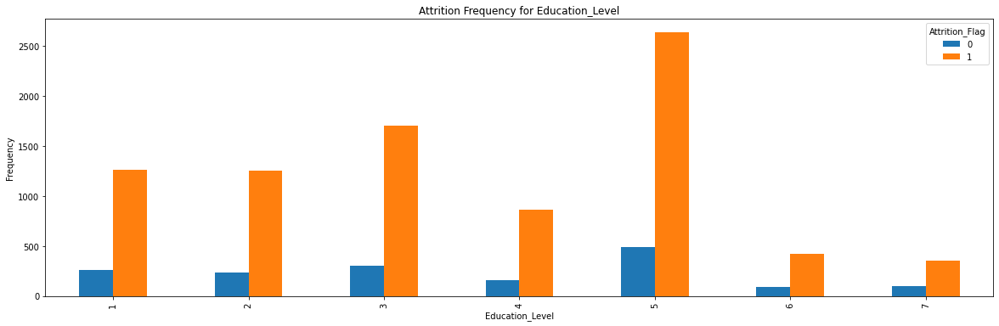

In [24]:
pd.crosstab(data.Education_Level,data.Attrition_Flag).plot(kind="bar",figsize=(20,6))
plt.title('Attrition Frequency for Education_Level')
plt.xlabel('Education_Level')
plt.ylabel('Frequency')
plt.show()

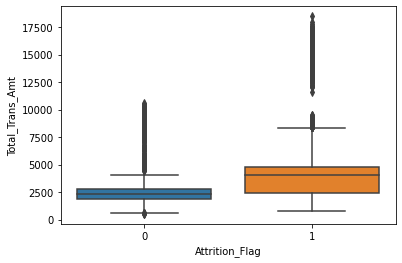

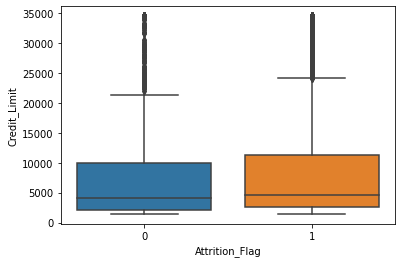

In [25]:
sns.boxplot(x=data['Attrition_Flag'],y=data['Total_Trans_Amt'])#箱形图
plt.show()
sns.boxplot(x=data['Attrition_Flag'],y=data['Credit_Limit'])#箱形图
plt.show()

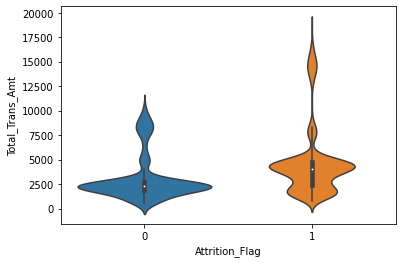

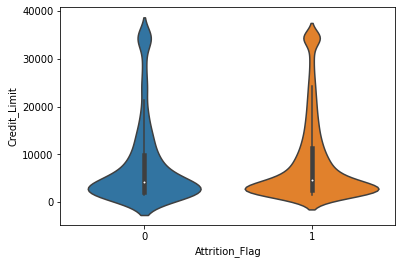

In [26]:
sns.violinplot(x=data['Attrition_Flag'],y=data['Total_Trans_Amt'])#小提琴图  
plt.show()
sns.violinplot(x=data['Attrition_Flag'],y=data['Credit_Limit'])
plt.show()

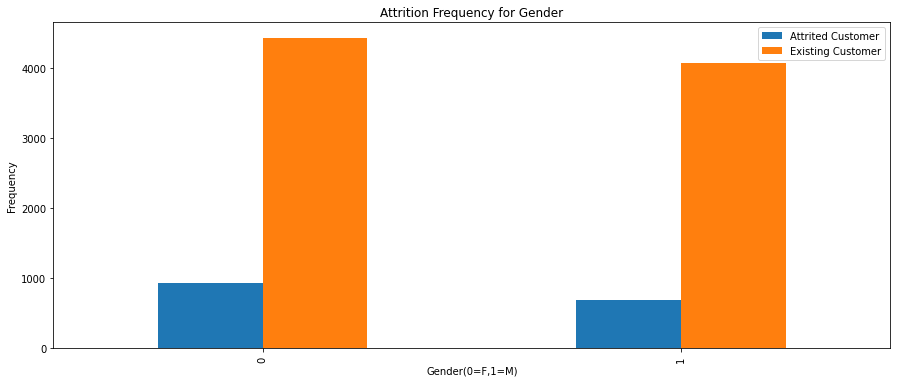

In [27]:
#不同性别的是否需要联系的比例
#单列特征与标签的关系
pd.crosstab(data.Gender,data.Attrition_Flag).plot(kind="bar",figsize=(15,6))
plt.title('Attrition Frequency for Gender')
plt.xlabel('Gender(0=F,1=M)')
plt.legend(['Attrited Customer','Existing Customer'])
plt.ylabel('Frequency')
plt.show()

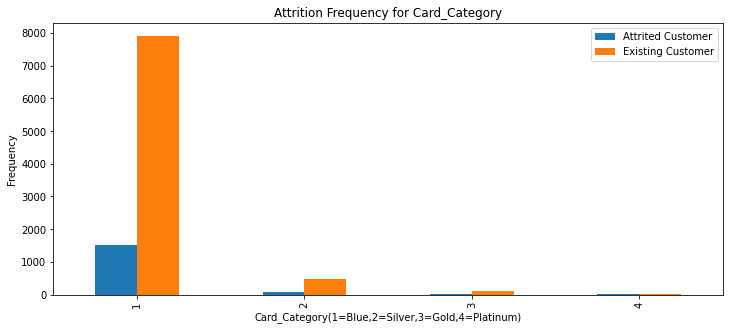

In [28]:
pd.crosstab(data.Card_Category,data.Attrition_Flag).plot(kind="bar",figsize=(12,5))
plt.title('Attrition Frequency for Card_Category')
plt.xlabel('Card_Category(1=Blue,2=Silver,3=Gold,4=Platinum)')
plt.legend(['Attrited Customer','Existing Customer'])
plt.ylabel('Frequency')
plt.show()

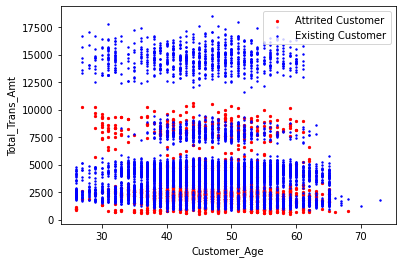

In [29]:
plt.scatter(x=data.Customer_Age[data.Attrition_Flag==0],y=data.Total_Trans_Amt[(data.Attrition_Flag==0)],s=5,c="red")#散点图
plt.scatter(x=data.Customer_Age[data.Attrition_Flag==1],y=data.Total_Trans_Amt[(data.Attrition_Flag==1)],s=2,c="blue")
plt.legend(['Attrited Customer','Existing Customer'])
plt.xlabel("Customer_Age")
plt.ylabel("Total_Trans_Amt")
plt.show()

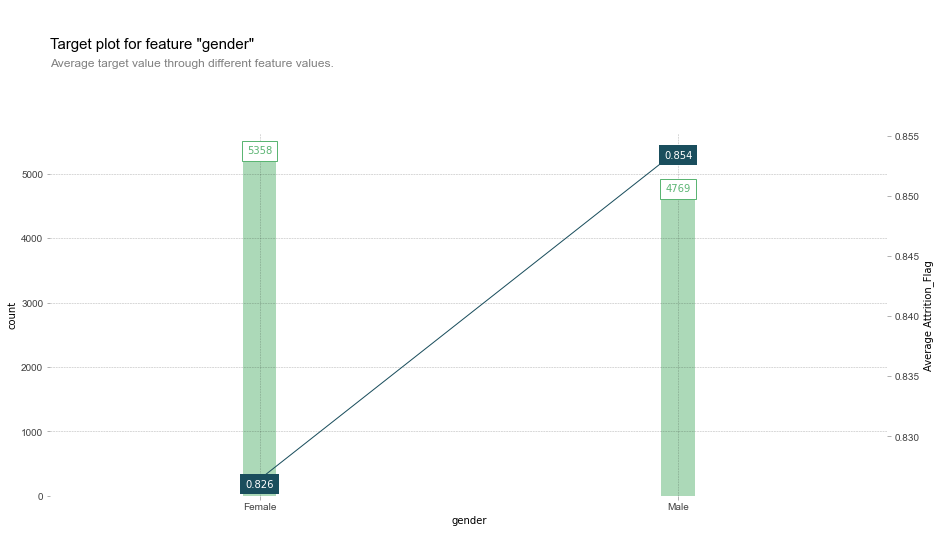

In [30]:
import warnings
warnings.filterwarnings("ignore")
from pdpbox import pdp,get_dataset,info_plots
fig,axes,summary_data=info_plots.target_plot(df=data,feature='Gender',feature_name='gender',target=['Attrition_Flag'])
_=axes['bar_ax'].set_xticklabels(['Female','Male'])

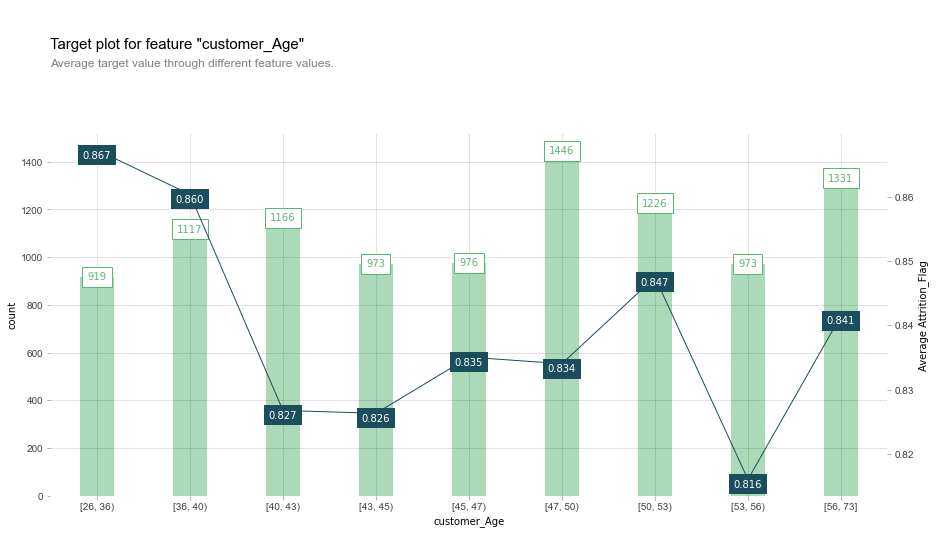

In [31]:
fig,axes,summary_data=info_plots.target_plot(df=data,feature='Customer_Age',feature_name='customer_Age',target=['Attrition_Flag'])
_=axes['bar_ax'].set_xticklabels(['[26, 36)','[36, 40)','[40, 43)','[43, 45)','[45, 47)','[47, 50)','[50, 53)','[53, 56)','[56, 73]'])

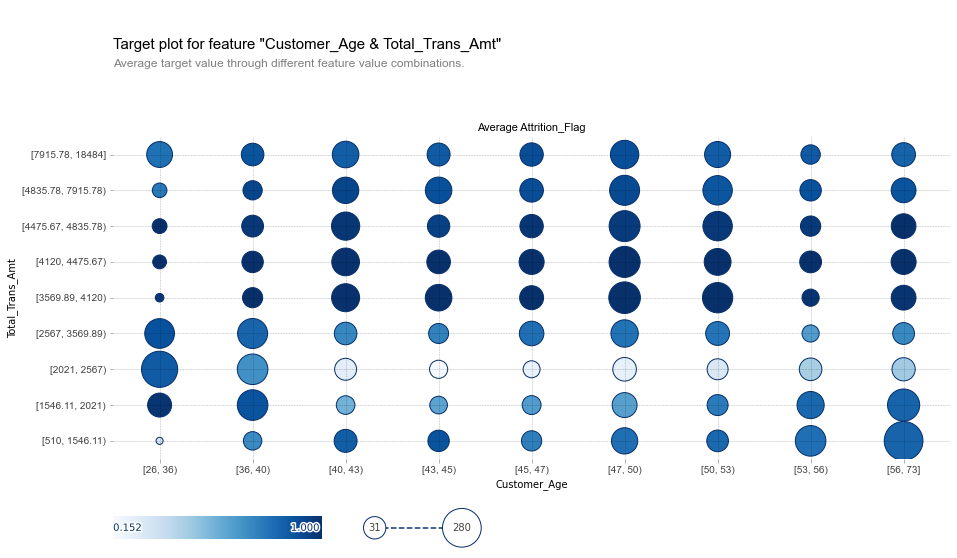

In [32]:
feat_name1='Customer_Age'#两个特征之间的关系
nick_name1='Customer_Age'
feat_name2='Total_Trans_Amt'
nick_name2='Total_Trans_Amt'
fig,axes,sumary_df=info_plots.target_plot_interact(df=data,features=[feat_name1,feat_name2],feature_names=[nick_name1,nick_name2],target='Attrition_Flag')
plt.show()

In [40]:
#fig=sns.boxplot(x="Total_Trans_Amt", y="Attrition_Flag", data=data)#通过观察发现，样本各特征的量纲和数量级不均衡。要进行标准差标准化

In [41]:
# data_max_min=(data.drop('Attrition_Flag',axis=1)-data.drop('Attrition_Flag',axis=1).min())/(data.drop('Attrition_Flag',axis=1).max()-data.drop('Attrition_Flag',axis=1).min())
# data_std=(data.drop('Attrition_Flag',axis=1)-data.drop('Attrition_Flag',axis=1).mean())/(data.drop('Attrition_Flag',axis=1).std())
# data_max_min['Attrition_Flag']=data['Attrition_Flag']
# data_std['Attrition_Flag']=data['Attrition_Flag']

In [42]:
# data_std['Attrition_Flag'].value_counts().plot(kind='bar',title='Category statistics')


In [43]:
# data_std=pd.concat([data_std[data_std['Attrition_Flag']==1].sample(frac=0.25).reset_index(drop=True),data_std[data_std['Attrition_Flag']==0]],axis=0)
# data_std['Attrition_Flag'].value_counts().plot(kind='bar',title='Category statistics')
# data_std

In [33]:
#data.to_csv('data.csv',index=None)

Label=data.iloc[:,0]#label
data.drop(columns=['Attrition_Flag'],inplace=True)
# data['Attrition_Flag']=Label
data=pd.concat([data,Label],axis=1)


In [34]:
# data_std.to_csv('data_std.csv',index=None)
data

,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,Attrition_Flag
0,45,1,3,3,3,4,1,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,1
1,49,0,5,5,1,2,1,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,1
2,51,1,3,5,3,5,1,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,1
3,40,0,4,3,0,2,1,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,1
4,40,1,3,2,3,4,1,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,50,1,2,5,1,3,1,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,1
10123,41,1,2,1,2,3,1,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0
10124,44,0,1,3,3,2,1,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0
10125,30,1,2,5,0,3,1,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0


In [35]:
data.to_csv('data.csv',index=None)


In [36]:
#模型训练
y=data.iloc[:,-1]
x=data.iloc[:,:19]#label
from sklearn.model_selection import train_test_split
xtrain,xtest,ytrain,ytest = train_test_split(x,y,test_size=0.25)
x

,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,45,1,3,3,3,4,1,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,49,0,5,5,1,2,1,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,51,1,3,5,3,5,1,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,40,0,4,3,0,2,1,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,40,1,3,2,3,4,1,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,50,1,2,5,1,3,1,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462
10123,41,1,2,1,2,3,1,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511
10124,44,0,1,3,3,2,1,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000
10125,30,1,2,5,0,3,1,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000


In [37]:
xtest

,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
8512,45,0,3,6,3,2,1,32,2,3,2,2726.0,2127,599.0,0.814,5578,89,0.854,0.780
7774,43,1,4,3,3,6,1,30,3,2,3,17228.0,1331,15897.0,0.519,2229,44,0.375,0.077
9547,29,0,1,2,1,2,1,36,1,2,1,3640.0,1419,2221.0,0.749,13306,99,0.678,0.390
9037,48,1,4,5,3,5,1,40,1,1,3,28307.0,1506,26801.0,0.818,9042,122,0.605,0.053
1951,26,1,1,4,2,3,1,21,3,3,2,1438.3,0,1438.3,0.745,2660,89,0.712,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6167,51,0,0,2,3,1,1,36,6,3,2,5881.0,0,5881.0,0.710,4431,89,0.816,0.000
2893,45,0,2,1,1,2,1,41,6,2,2,5596.0,0,5596.0,0.833,3212,64,0.422,0.000
8664,59,0,1,3,1,2,1,46,2,3,2,7484.0,1939,5545.0,0.994,4923,56,0.333,0.259
8476,53,0,1,4,3,2,1,36,1,3,3,1665.0,964,701.0,1.049,4881,75,0.923,0.579


In [38]:
import itertools
def cnf_matrix_plotter(cm,classes):
    plt.imshow(cm,interpolation='nearest',cmap=plt.cm.Greens)
    plt.title('Confusion Matrix')
    plt.colorbar()
    tick_marks=np.arange(len(classes))
    plt.xticks(tick_marks,classes)
    plt.yticks(tick_marks,classes)
    threshold=cm.max()/2
    for i,j in itertools.product(range(cm.shape[0]),range(cm.shape[1])):
        plt.text(j,i,cm[i,j],
                horizontalalignment="center",
                color="white" if cm[i,j]>threshold else "black",
                fontsize=25)
    plt.tight_layout()
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    
    plt.show()

In [39]:
def draw_ROC(y_pred_quant):
    from sklearn.metrics import roc_curve,auc
    fpr,tpr,thresholds=roc_curve(ytest,y_pred_quant)
    fpr#TPR=TP/(TP+TN)
    tpr#FPR=FP/(FP+TN)
    thresholds
    plt.plot(fpr,tpr)
    plt.plot([0,1],[0,1],ls="--",c=".3")
    plt.xlim([0.0,1.0])
    plt.ylim([0.0,1.0])
    plt.rcParams['font.size']=12
    plt.title('ROC curve')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.grid(True)
    print(auc(fpr,tpr))#面积

1.0
0.9589257503949447
[[1557   70]
 [  34 8466]]


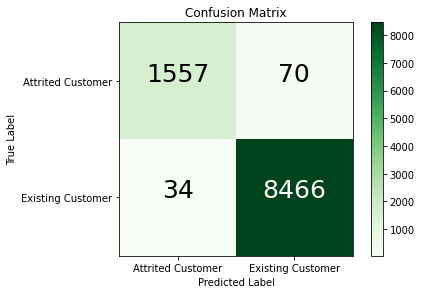

0.986446599267972


,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,97.8630,95.6976,98.973,0.967682
1,Existing Customer,99.1799,99.6000,98.973,0.993895


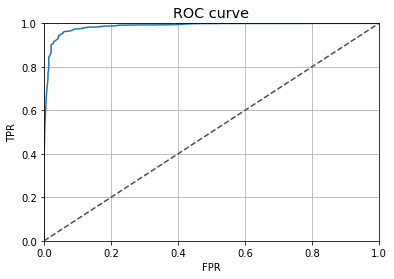

In [40]:
#随机森林
from sklearn import model_selection
from sklearn.ensemble import RandomForestClassifier#abc
from sklearn.ensemble import ExtraTreesClassifier#abc
rfc=RandomForestClassifier()
model=rfc.fit(xtrain,ytrain)
print(rfc.score(xtrain,ytrain))
print(rfc.score(xtest,ytest))
from sklearn.metrics import confusion_matrix
cm=np.array(confusion_matrix(y,rfc.predict(x)))
y_pred_quant=rfc.predict_proba(xtest)[:,1]
print(cm)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_rfc = np.round(100*TP/(TP+FP),4)  #精确率
Recall_rfc = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_rfc = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_rfc = (np.round(2*Precision_rfc*Recall_rfc/(Precision_rfc+Recall_rfc),4)) #F1-score
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
draw_ROC(y_pred_quant)
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_rfc,'recall':Recall_rfc,'accuracy':Accuracy_rfc,'F1-score':F1_rfc/100}
df = pd.DataFrame(data0)
df

In [41]:
depth=rfc.max_depth
print(depth)

None


In [42]:
len(rfc.estimators_)
estimator=rfc.estimators_[50]#第50棵树
#将特征转为字符串
feature_names=xtrain.columns.values.tolist()
print(feature_names)
ytrain_str=ytrain.astype('str')
ytrain_str[ytrain_str=='0']='Attrited Customer'
ytrain_str[ytrain_str=='1']='Existing Customer'
ytrain_str=ytrain_str.values
from sklearn.tree import export_graphviz
export_graphviz(estimator,out_file='tree.dot',feature_names=feature_names,class_names=ytrain_str,
               rounded=True,proportion=True,label='root',precision=2,filled=True)
from subprocess import call
call(['dot','-Tpng','tree.dot','-o','tree.png','-Gdpi=600'],shell=True)
import os
os.environ["PATH"] += os.pathsep + 'C:/Program Files/Graphviz/bin'
os.system('dot -Tpng tree.dot -o tree.png')
from IPython.display import Image
Image(filename='tree.png')

['Customer_Age', 'Gender', 'Dependent_count', 'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category', 'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon', 'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal', 'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt', 'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']


In [43]:
import eli5
eli5.show_weights(estimator,feature_names=feature_names)

Weight,Feature
0.2450,Total_Trans_Ct
0.1528,Avg_Utilization_Ratio
0.1400,Total_Ct_Chng_Q4_Q1
0.1241,Total_Trans_Amt
0.0554,Total_Revolving_Bal
0.0413,Avg_Open_To_Buy
0.0399,Total_Amt_Chng_Q4_Q1
0.0305,Credit_Limit
0.0230,Total_Relationship_Count
0.0224,Months_on_book


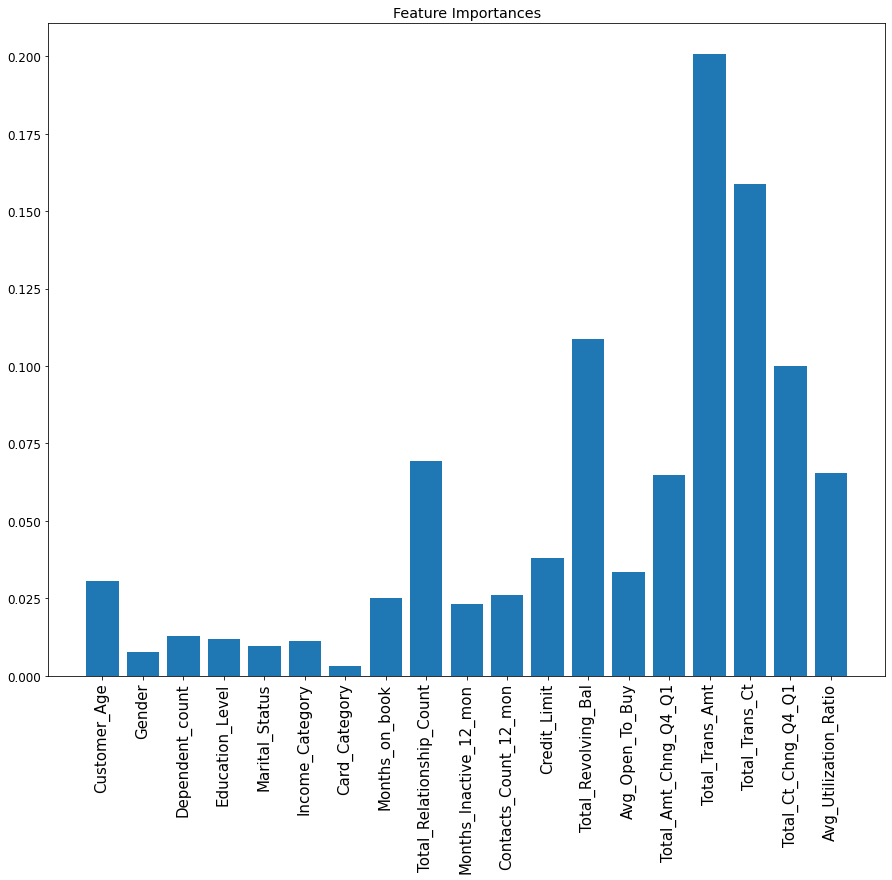

In [44]:
#检测重要特征
# rf = RandomForestClassifier()
# rf.fit(X, y)
# name_list=['Customer_Age','Dependent_count','Education_Level','Income_Category','Card_Category','Months_on_book','Total_Relationship_Count'
#           ,'Months_Inactive_12_mon','Contacts_Count_12_mon','Credit_Limit','Total_Revolving_Bal','Avg_Open_To_Buy'
#           ,'Total_Amt_Chng_Q4_Q1','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_Q4_Q1','Avg_Utilization_Ratio'
#           ,'x0_F','x0_M','x0_Divorced','x0_Married','x0_Single','x0_Unknown']
name_list=['Customer_Age','Gender','Dependent_count','Education_Level','Marital_Status','Income_Category','Card_Category','Months_on_book','Total_Relationship_Count'
          ,'Months_Inactive_12_mon','Contacts_Count_12_mon','Credit_Limit','Total_Revolving_Bal','Avg_Open_To_Buy'
          ,'Total_Amt_Chng_Q4_Q1','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_Q4_Q1','Avg_Utilization_Ratio']
f, ax = plt.subplots(figsize=(15, 12))
# ax.bar(range(len(rfc.feature_importances_)),rfc.feature_importances_,tick_label=name_list)
ax.bar(range(len(rfc.feature_importances_)),rfc.feature_importances_,tick_label=name_list)
ax.set_xticklabels(name_list,fontsize=15,rotation=90)

ax.set_title("Feature Importances")
# classes=['Attrition_Flag','Customer_Age']
# tick_marks = np.array(range(len(classes))) + 1
# ax.set_xticks(name_list, minor=True)
f.show()

In [45]:
#绘制permutation importance  绿色表示重要   打乱之后对模型造成影响  红色是负向的特征
#绿色的列是对模型来说比较重要的。Permutation Importance图就是看哪个特征对模型有重要影响
import eli5
from eli5.sklearn import PermutationImportance
perm=PermutationImportance(rfc,random_state=1).fit(xtest,ytest)
eli5.show_weights(perm,feature_names=xtest.columns.values.tolist())

Weight,Feature
0.1140 ± 0.0071,Total_Trans_Ct
0.0573 ± 0.0064,Total_Trans_Amt
0.0315 ± 0.0069,Total_Relationship_Count
0.0268 ± 0.0034,Total_Revolving_Bal
0.0137 ± 0.0015,Total_Ct_Chng_Q4_Q1
0.0050 ± 0.0028,Total_Amt_Chng_Q4_Q1
0.0048 ± 0.0014,Customer_Age
0.0021 ± 0.0028,Months_Inactive_12_mon
0.0013 ± 0.0014,Contacts_Count_12_mon
0.0001 ± 0.0003,Card_Category


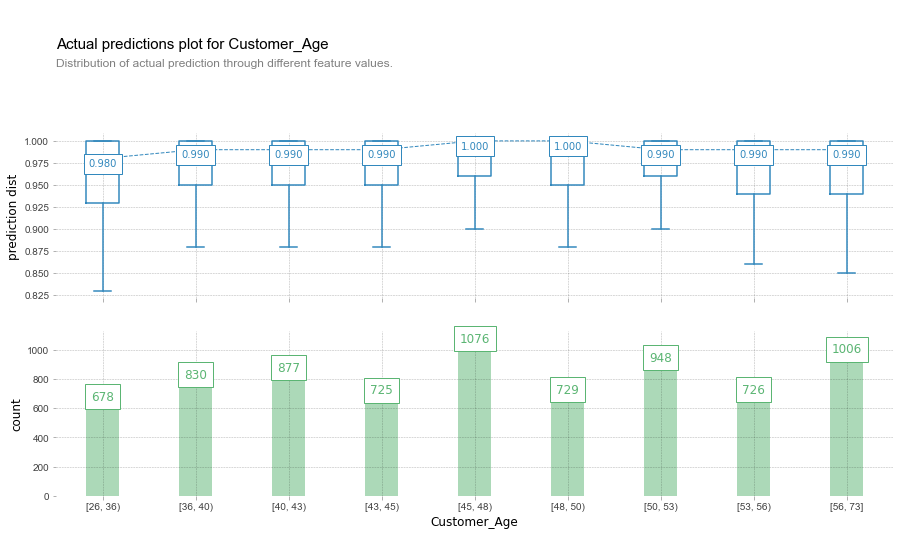

In [47]:
#pdp图
from pdpbox import pdp,get_dataset,info_plots
#与先验数据集的区别
# fig,axes,summary_df=info_plots.actual_plot(predict_kwds={},model=rfc,X=data,feature='Gender',feature_name=='gender')
fig,axes,summary_df=info_plots.actual_plot(model=rfc,X=xtrain,feature="Customer_Age",feature_name="Customer_Age",predict_kwds={})

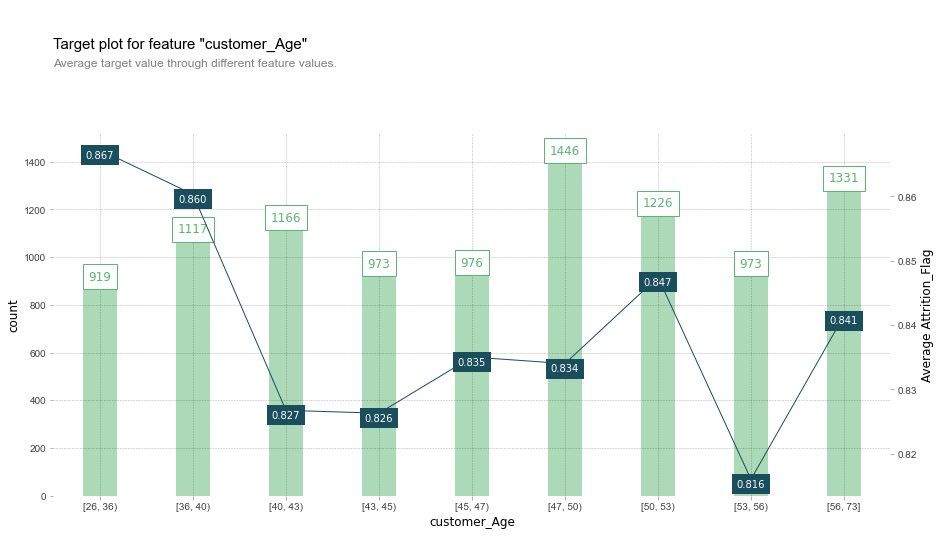

In [48]:
fig,axes,summary_data=info_plots.target_plot(df=data,feature='Customer_Age',feature_name='customer_Age',target=['Attrition_Flag'])
_=axes['bar_ax'].set_xticklabels(['[26, 36)','[36, 40)','[40, 43)','[43, 45)','[45, 47)','[47, 50)','[50, 53)','[53, 56)','[56, 73]'])

ValueError: The number of FixedLocator locations (0), usually from a call to set_ticks, does not match the number of ticklabels (2).

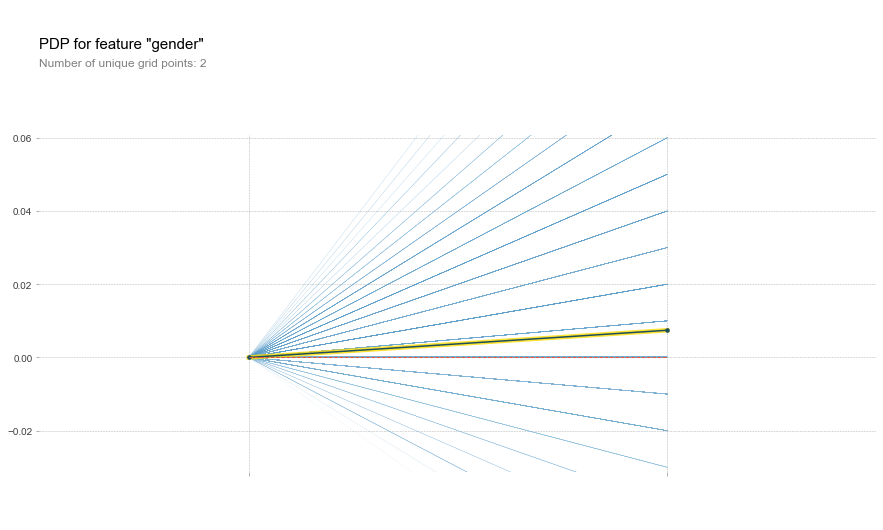

In [49]:
#ICE图
base_features=xtest.columns.values.tolist()#女性变男性时，预测结果的变化   下面就是特征由女性变成男性，每一个样本预测的概率会变大
feat_name='Gender'
nick_name='gender'
pdp_dist=pdp.pdp_isolate(model=rfc,dataset=xtest,model_features=base_features,feature=feat_name)
fig,axes=pdp.pdp_plot(pdp_dist,nick_name,plot_lines=True,frac_to_plot=0.8,plot_pts_dist=True)

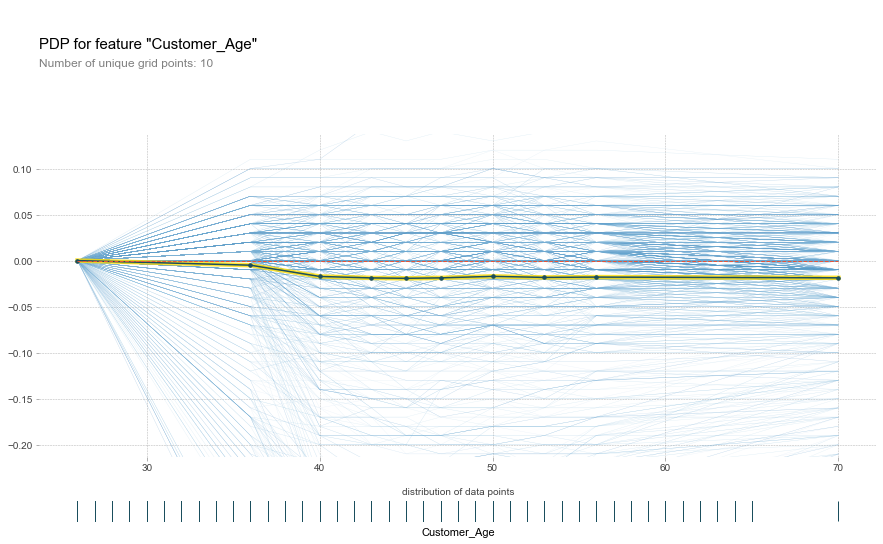

In [50]:
base_features=xtest.columns.values.tolist()#年龄，每个样本对预测结果的变化
feat_name='Customer_Age'
nick_name='Customer_Age'
pdp_dist=pdp.pdp_isolate(model=rfc,dataset=xtest,model_features=base_features,feature=feat_name)
fig,axes=pdp.pdp_plot(pdp_dist,nick_name,plot_lines=True,frac_to_plot=0.5,plot_pts_dist=True)

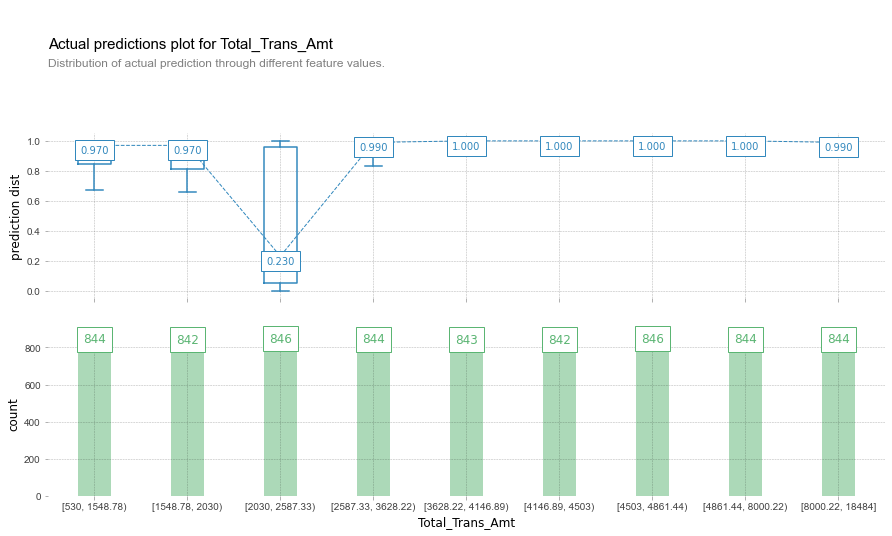

In [52]:
#pdp图
from pdpbox import pdp,get_dataset,info_plots
#与先验数据集的区别
# fig,axes,summary_df=info_plots.actual_plot(predict_kwds={},model=rfc,X=data,feature='Gender',feature_name=='gender')
fig,axes,summary_df=info_plots.actual_plot(model=rfc,X=xtrain,feature="Total_Trans_Amt",feature_name="Total_Trans_Amt",predict_kwds={})

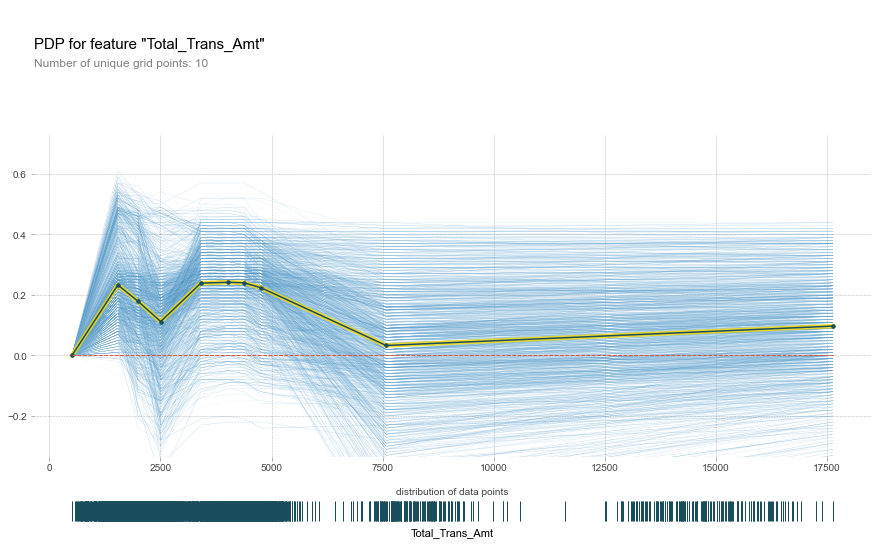

In [53]:

base_features=xtest.columns.values.tolist()#
feat_name='Total_Trans_Amt'
nick_name='Total_Trans_Amt'
pdp_dist=pdp.pdp_isolate(model=rfc,dataset=xtest,model_features=base_features,feature=feat_name)
fig,axes=pdp.pdp_plot(pdp_dist,nick_name,plot_lines=True,frac_to_plot=0.5,plot_pts_dist=True)

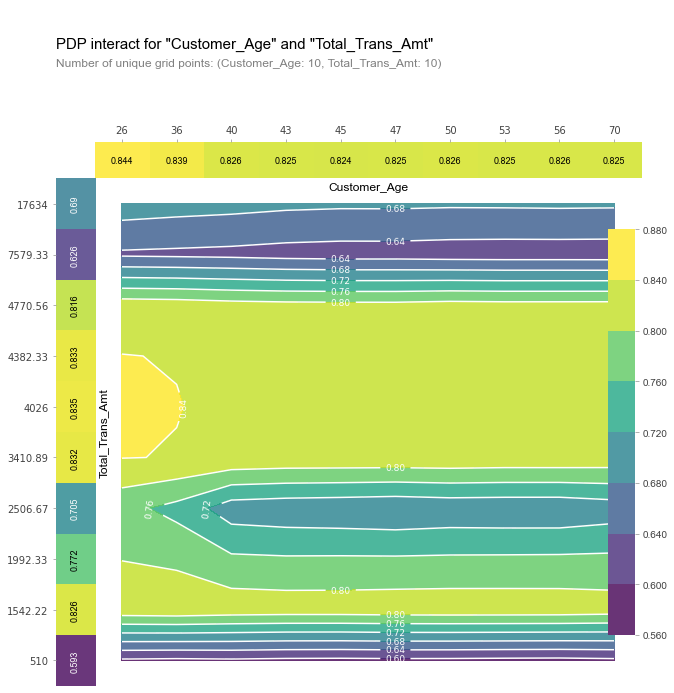

In [54]:
feat_name1="Customer_Age"#二维的PDP图（表达特征之间的交互关系）
nick_name1="Customer_Age"
feat_name2="Total_Trans_Amt"
nick_name2="Total_Trans_Amt"
inter1=pdp.pdp_interact(model=rfc,dataset=xtest,model_features=base_features,features=[feat_name1,feat_name2])
fig,axes=pdp.pdp_interact_plot(pdp_interact_out=inter1,feature_names=[nick_name1,nick_name2],plot_type="contour",x_quantile=True,plot_pdp=True)

In [55]:
#计算测试集每个样本的每个特征对两类预测结果的SHAPE值
import shap
shap.initjs()
explainer=shap.TreeExplainer(rfc)
shap_values=explainer.shap_values(xtest)
shap_values

[array([[ 2.48388001e-03,  1.43125276e-03,  5.96660640e-04, ...,
         -1.05657736e-01, -2.52922920e-02, -8.22680742e-03],
        [ 1.88413375e-02, -1.59738281e-02,  2.04175441e-02, ...,
          1.66303378e-01,  1.56020138e-01, -4.88855099e-02],
        [ 4.57604395e-03,  1.94059946e-03, -1.86882077e-04, ...,
         -1.27501201e-01, -1.52646104e-02, -1.15530708e-02],
        ...,
        [-5.22546983e-04,  2.11283549e-03, -1.64369524e-03, ...,
          6.77908716e-02,  2.06041702e-01, -2.27800394e-02],
        [ 2.12301425e-03, -2.59739463e-04, -1.39351197e-03, ...,
         -9.24248313e-02, -2.58829650e-02, -1.83949084e-02],
        [ 5.66703429e-03, -3.65618504e-03,  2.77937044e-03, ...,
          7.59928245e-02, -5.17256421e-02,  7.42200414e-02]]),
 array([[-2.48388001e-03, -1.43125276e-03, -5.96660640e-04, ...,
          1.05657736e-01,  2.52922920e-02,  8.22680742e-03],
        [-1.88413375e-02,  1.59738281e-02, -2.04175441e-02, ...,
         -1.66303378e-01, -1.56020138e

In [56]:
shap_values[1].shape
#对测试集所有样本，预测为需要联系和不需要联系的客户各自的平均概率
explainer.expected_value
##可以认为是一个期望
#对某个样本，模型预测为的概率为测试集不需要联系的客户的平均概率和该样本各特征对不需要联系的客户预测结果的shap值之和。
#对某个样本，模型预测不需要联系的客户的概率就是explainer.expected_value[1]与该样本各个特征shap值之和。

array([0.15725214, 0.84274786])

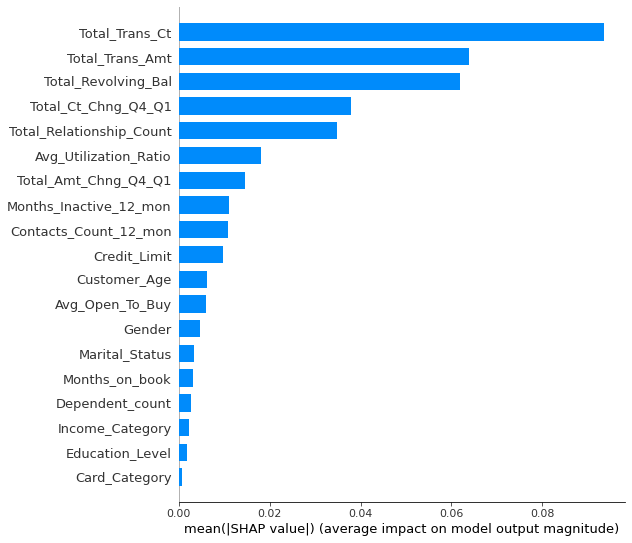

In [57]:
#SHAP值可视化分析
#特征重要度
#对于某个特征，计算测试集每个客户的该特征shap值之和，shap值越高，特征越重要
shap.summary_plot(shap_values[1],xtest,plot_type='bar')
#已经用过三种构建特征重要度的方法了。使用weight,PermutationImportance和shap这三种方式衡量特征重要度.

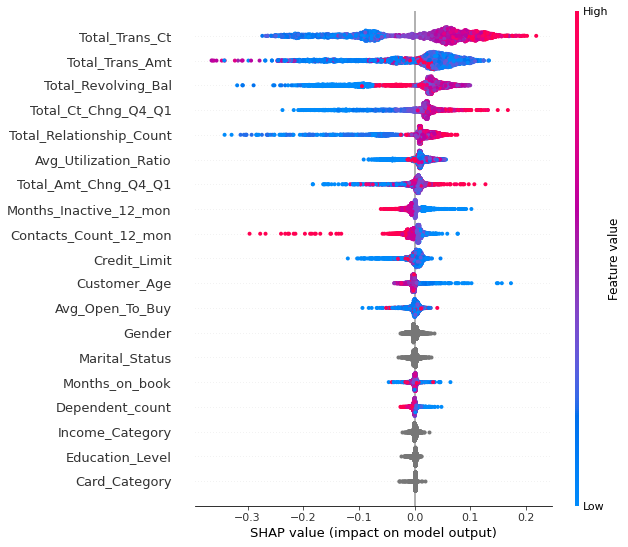

In [58]:
#各个特征的数值大小和各特征的SHAP值关系图
#summary plot为每个样本绘制其每个特征的shap值，每一行代表一个特征，横坐标为shap值。一个点代表一个样本，颜色表示特征值（红色高，蓝色低）
#每一行表示一个特征，红色表示该特征的值较高的数据点，蓝色表示该特征较低的数据点

#越往右边是正向贡献，越往左边是负向贡献
shap.summary_plot(shap_values[1],xtest)

In [ ]:
# shap_interaction_values=explainer.shap_interaction_values(xtest)
# shap.summary_plot(shap_interaction_values[1],xtest)

In [59]:
xtest.head()

,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
8512,45,0,3,6,3,2,1,32,2,3,2,2726.0,2127,599.0,0.814,5578,89,0.854,0.780
7774,43,1,4,3,3,6,1,30,3,2,3,17228.0,1331,15897.0,0.519,2229,44,0.375,0.077
9547,29,0,1,2,1,2,1,36,1,2,1,3640.0,1419,2221.0,0.749,13306,99,0.678,0.390
9037,48,1,4,5,3,5,1,40,1,1,3,28307.0,1506,26801.0,0.818,9042,122,0.605,0.053
1951,26,1,1,4,2,3,1,21,3,3,2,1438.3,0,1438.3,0.745,2660,89,0.712,0.000


In [60]:
idx=8512
customer=x.iloc[idx,:]
customer_df=x.loc[idx:idx]
customer


Customer_Age                   45
Gender                          0
Dependent_count                 3
Education_Level                 6
Marital_Status                  3
Income_Category                 2
Card_Category                   1
Months_on_book                 32
Total_Relationship_Count        2
Months_Inactive_12_mon          3
Contacts_Count_12_mon           2
Credit_Limit                 2726
Total_Revolving_Bal          2127
Avg_Open_To_Buy               599
Total_Amt_Chng_Q4_Q1        0.814
Total_Trans_Amt              5578
Total_Trans_Ct                 89
Total_Ct_Chng_Q4_Q1         0.854
Avg_Utilization_Ratio        0.78
Name: 8512, dtype: object

In [61]:
shap.summary_plot(shap_interaction_values[1][0],xtest,plot_type='bar')

NameError: name 'shap_interaction_values' is not defined

In [62]:
##计算该病人的各个特征对需要和不需要联系的客户两个预测结果的shap值
model_predict_proba=rfc.predict_proba(customer_df)[0][1]
print('{}号客户的真实标签是{}，模型预测为{:.2f}'.format(idx,bool(ytest[idx]),model_predict_proba))
shap_values_customer=explainer.shap_values(customer)
shap_values_customer[1]#不需要联系的客户的shap值
shap.force_plot(explainer.expected_value[1],shap_values_customer[1],customer)
##红色:有正向贡献的特征，蓝色，负向贡献的特征。红条越大，表示shap越大。
##红条减去蓝条：是base value平均结果到最终预测结果之间的差距

8512号客户的真实标签是True，模型预测为1.00


In [63]:
#测试集所有样本的SUMMARYPLOT
#将测试集所有样本的force plot旋转九十度并拼接在一起，形成summary plot
#可以在下拉菜单选择按照相似性聚类展示、按照预测结果概率从到小展示，按照测试集原本样本顺序、按照某个特征分别展示。
number_show=60
shap_values_summary=explainer.shap_values(xtrain.iloc[:number_show])
shap.force_plot(explainer.expected_value[1],shap_values_summary[1],xtest.iloc[:number_show])

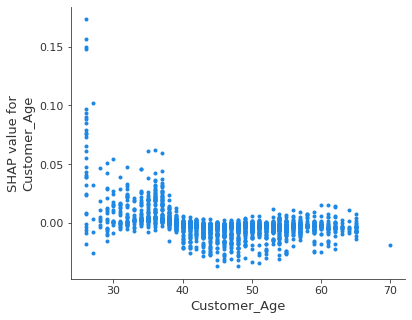

In [64]:
#DEPENDENCE PLOT
#展示某个特征从小变大时对预测结果的shap值。
shap.dependence_plot("Customer_Age",shap_values[1],xtest,interaction_index=None)

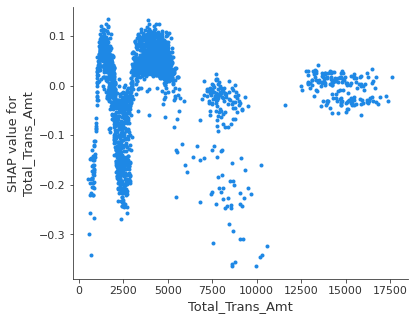

In [65]:
shap.dependence_plot("Total_Trans_Amt",shap_values[1],xtest,interaction_index=None)

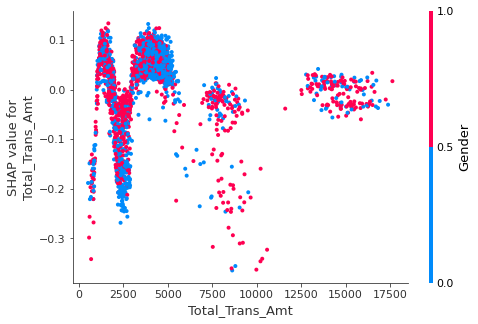

In [66]:
shap.dependence_plot("Total_Trans_Amt",shap_values[1],xtest,interaction_index="Gender")
##男人和女人分别解释

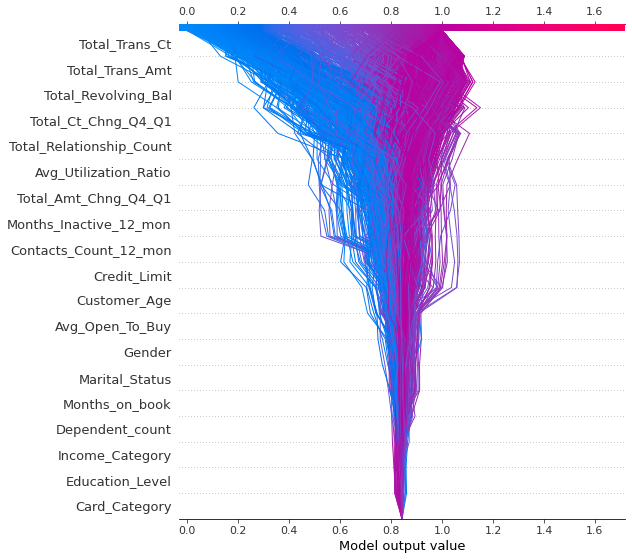

In [67]:
#决策图
#瀑布图只能展示单个数据的决策过程，决策图可以展示测试集所有数据的决策过程
#决策图主要是展示所有数据的决策路径.
shap.decision_plot(explainer.expected_value[1],shap_values[1],xtest.iloc[0:50,:],ignore_warnings=True)

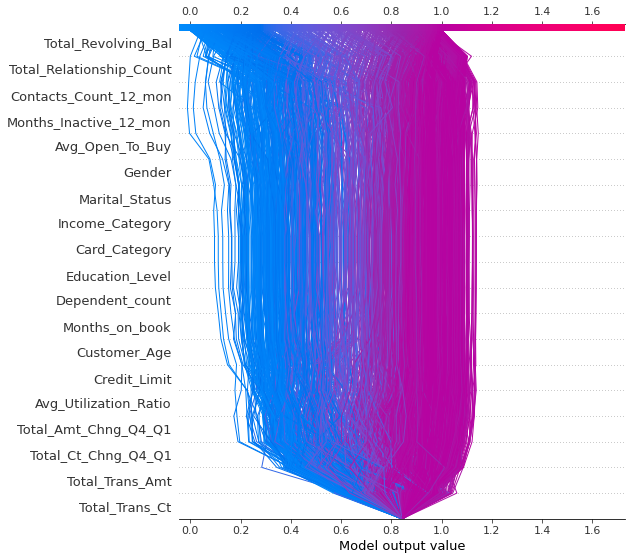

In [68]:
shap.decision_plot(explainer.expected_value[1],shap_values[1],xtest,feature_order="hclust",ignore_warnings=True)

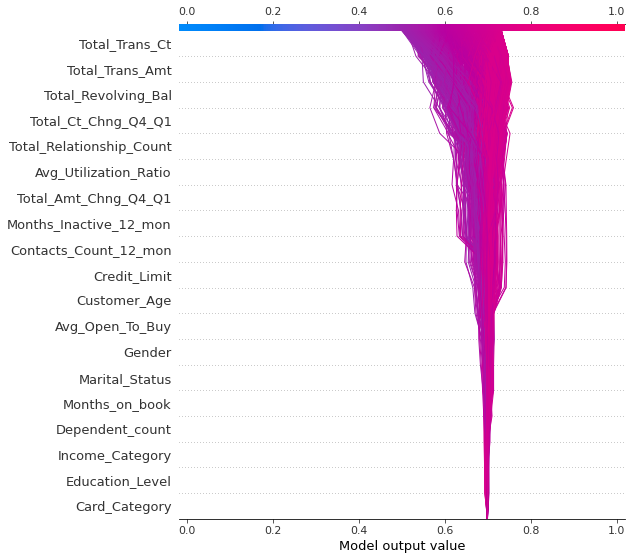

In [69]:
##加入link='logit'参数，进行对数几率缩放变换
shap.decision_plot(explainer.expected_value[1],shap_values[1],xtest,link='logit',ignore_warnings=True)

索引号为80的样本，在原始数据集X中的索引号为1170


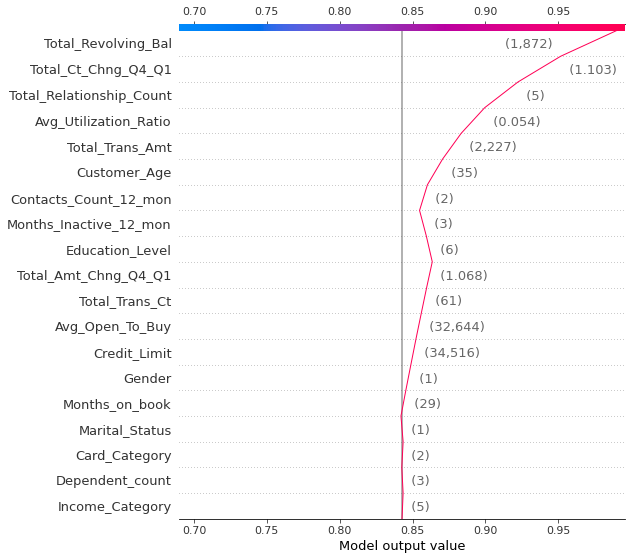

In [70]:
idx=80
selection=np.zeros((xtest.shape[0]))
selection[idx]=1
selection=selection>0
print("索引号为{}的样本，在原始数据集X中的索引号为{}".format(idx,xtest.iloc[idx:idx+1].index[0]))
shap.decision_plot(explainer.expected_value[1],shap_values[1][selection],xtest[selection])

In [71]:
#选出测试集中模型预测错误的样本
ypred=rfc.predict(xtest)
misclassified=ypred != ytest
misclassified_df=pd.DataFrame({'是否预测错误':misclassified})
misclassified_df
misclassified_df=misclassified_df[misclassified_df['是否预测错误']==True]
misclassified_df

,是否预测错误
7774,True
1351,True
597,True
3475,True
3071,True
...,...
4850,True
6811,True
6957,True
9754,True


In [72]:
##拿出某个预测错误的客户
idx=7774
patient=x.iloc[idx,:]
patient_df=x.loc[idx:idx]
model_predict_proba=model.predict_proba(patient_df)[0][1]
print('{}号客户的真实标签是{},模型预测为{:.2f}'.format(idx,bool(ytest[idx]),model_predict_proba))
shap_values_patient=explainer.shap_values(patient)
shap.force_plot(explainer.expected_value[1],shap_values_patient[1],patient)

7774号客户的真实标签是False,模型预测为0.54


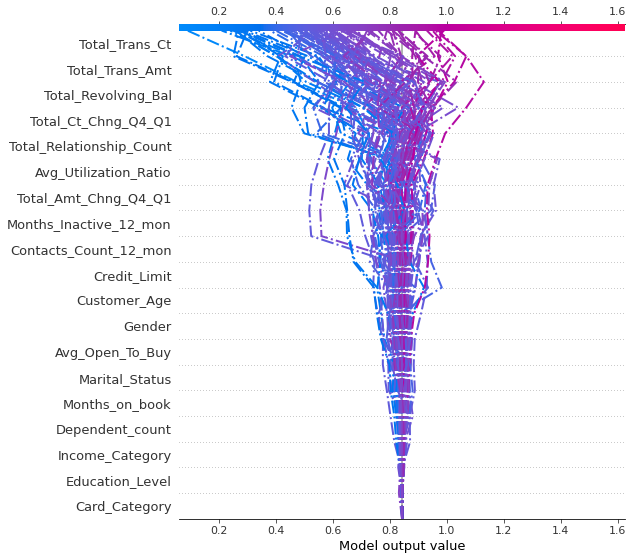

In [73]:
#在决策图中显示测试集中模型预测错误的样本
shap.decision_plot(explainer.expected_value[1],shap_values[1][misclassified],xtest[misclassified],highlight=range(len(misclassified_df)))


In [58]:
# from sklearn.preprocessing import StandardScaler
# sc = StandardScaler()   #初始化一个对象sc去对数据集作变换
# sc.fit(xtrain)   #用对象去拟合数据集X_train，并且存下来拟合参数

# xtrain_std = sc.transform(xtrain)
# xtest_std = sc.transform(xtest)

0.8421329822251481
0.8309636650868878
[[   0 1627]
 [   0 8500]]


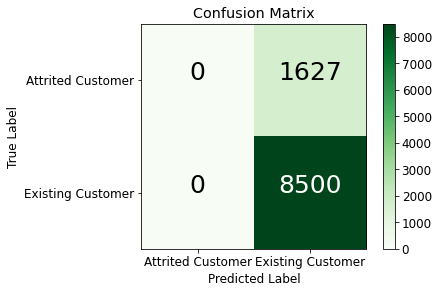

,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,NaN,0.0,83.934,NaN
1,Existing Customer,83.934,100.0,83.934,0.912653


In [74]:
from sklearn.linear_model import Perceptron#感知器做分类
#ppn = Perceptron(n_iter=40, eta0=0.1, random_state=0)
ppn = Perceptron()  #y=w.x+b
ppn.fit(xtrain, ytrain)
print(ppn.score(xtrain,ytrain))
print(ppn.score(xtest,ytest))
cm=np.array(confusion_matrix(y,ppn.predict(x)))
# y_pred_quant=ppn.predict_proba(xtest)[:,1]
print(cm)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_ppn = np.round(100*TP/(TP+FP),4)  #精确率
Recall_ppn = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_ppn = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_ppn = (np.round(2*Precision_ppn*Recall_ppn/(Precision_ppn+Recall_ppn),4)) #F1-score
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
# draw_ROC(y_pred_quant)
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_ppn,'recall':Recall_ppn,'accuracy':Accuracy_ppn,'F1-score':F1_ppn/100}
df = pd.DataFrame(data0)
df

0.889137590520079
0.881911532385466
[[ 657  970]
 [ 171 8329]]


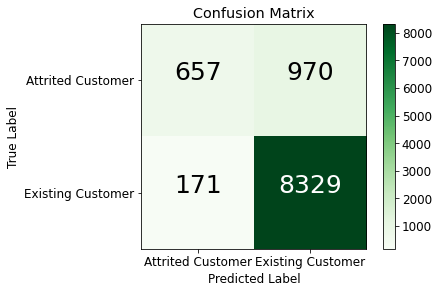

0.8912052254717316


,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,79.3478,40.3811,88.7331,0.535234
1,Existing Customer,89.5688,97.9882,88.7331,0.935895


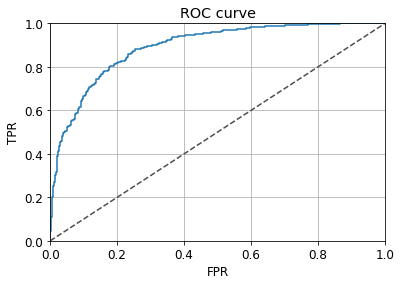

In [75]:
from sklearn.linear_model import LogisticRegression#逻辑回归
lr = LogisticRegression()
lr.fit(xtrain, ytrain)
print(lr.score(xtrain,ytrain))
print(lr.score(xtest,ytest))
cm=np.array(confusion_matrix(y,lr.predict(x)))
y_pred_quant=lr.predict_proba(xtest)[:,1]
print(cm)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_lr = np.round(100*TP/(TP+FP),4)  #精确率
Recall_lr = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_lr = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_lr = (np.round(2*Precision_lr*Recall_lr/(Precision_lr+Recall_lr),4)) #F1-score
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
draw_ROC(y_pred_quant)
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_lr,'recall':Recall_lr,'accuracy':Accuracy_lr,'F1-score':F1_lr/100}
df = pd.DataFrame(data0)
df

In [90]:
# from sklearn.svm import SVC#SVM
# svm = SVC(kernel='linear', C=1.0, random_state=0)
# svm.fit(xtrain, ytrain)
# print(svm.score(xtrain,ytrain))
# print(svm.score(xtest,ytest))
# cm=np.array(confusion_matrix(y,svm.predict(x)))
# print(cm)
# FP = cm.sum(axis=0) - np.diag(cm)   #假正例
# FN = cm.sum(axis=1) - np.diag(cm)   #假负例
# TP = np.diag(cm)                    #真正例
# TN = cm.sum() - (FP + FN + TP)      #真负例
# Precision = np.round(100*TP/(TP+FP),4)  #精确率
# Recall = np.round(100*TP/(TP+FN),4)  #召回率
# Accuracy = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
# F1 = (np.round(2*Precision*Recall/(Precision+Recall),4)) #F1-score
# data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision,'recall':Recall,'accuracy':Accuracy,'F1-score':F1/100}
# df = pd.DataFrame(data0)
# df

1.0
0.8309636650868878
[[1199  428]
 [   0 8500]]


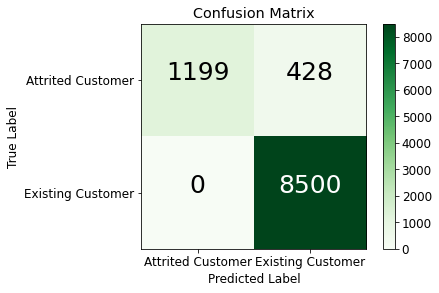

,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,100.0000,73.6939,95.7737,0.848549
1,Existing Customer,95.2061,100.0000,95.7737,0.975442


In [76]:
from sklearn.svm import SVC
svm = SVC(kernel='rbf',random_state=0,gamma=0.2,C=1.0)
svm.fit(xtrain, ytrain)
print(svm.score(xtrain,ytrain))
print(svm.score(xtest,ytest))
cm=np.array(confusion_matrix(y,svm.predict(x)))
# y_pred_quant=svm.predict_proba(xtest)[:,1]
print(cm)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_svm = np.round(100*TP/(TP+FP),4)  #精确率
Recall_svm = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_svm = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_svm = (np.round(2*Precision_svm*Recall_svm/(Precision_svm+Recall_svm),4)) #F1-score
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
# draw_ROC(y_pred_quant)
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_svm,'recall':Recall_svm,'accuracy':Accuracy_svm,'F1-score':F1_svm/100}
df = pd.DataFrame(data0)
df

1.0
0.9293048973143759
[[1542   85]
 [  94 8406]]


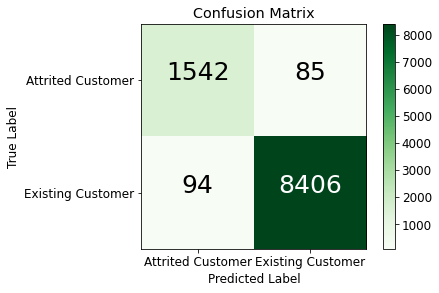

0.878362531537614


,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,94.2543,94.7757,98.2324,0.945143
1,Existing Customer,98.9989,98.8941,98.2324,0.989465


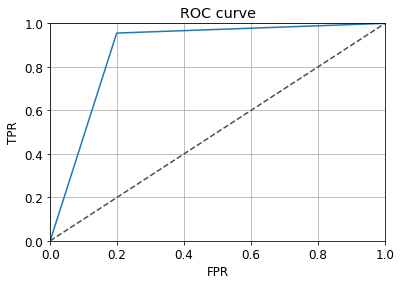

In [77]:
from sklearn.tree import DecisionTreeClassifier#决策树
tree = DecisionTreeClassifier(criterion='entropy',  random_state=0)
#特征选择的度量，entropy是信息增益；max_depth参数是数的最大深度
tree.fit(xtrain, ytrain)
print(tree.score(xtrain,ytrain))
print(tree.score(xtest,ytest))
cm=np.array(confusion_matrix(y,tree.predict(x)))
y_pred_quant=tree.predict_proba(xtest)[:,1]
print(cm)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_tree = np.round(100*TP/(TP+FP),4)  #精确率
Recall_tree = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_tree = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_tree = (np.round(2*Precision_tree*Recall_tree/(Precision_tree+Recall_tree),4)) #F1-score
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
draw_ROC(y_pred_quant)
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_tree,'recall':Recall_tree,'accuracy':Accuracy_tree,'F1-score':F1_tree/100}
df = pd.DataFrame(data0)
df

0.9133640552995391
0.8803317535545023
[[1058  569]
 [ 392 8108]]


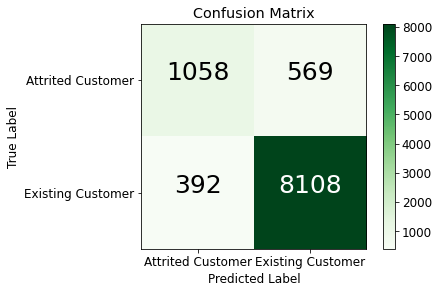

0.8856445000177676


,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,72.9655,65.0277,90.5105,0.687683
1,Existing Customer,93.4424,95.3882,90.5105,0.944053


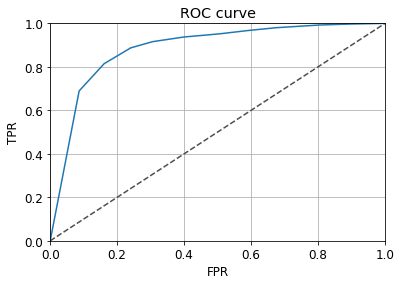

In [78]:
from sklearn.neighbors import KNeighborsClassifier#KNN
knn = KNeighborsClassifier(n_neighbors=10, p=2, metric='minkowski')
#p是度量范数，metric='minkowski'距离度量标准2范数
knn.fit(xtrain, ytrain)
print(knn.score(xtrain,ytrain))
print(knn.score(xtest,ytest))
cm=np.array(confusion_matrix(y,knn.predict(x)))
y_pred_quant=knn.predict_proba(xtest)[:,1]
print(cm)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_knn = np.round(100*TP/(TP+FP),4)  #精确率
Recall_knn = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_knn = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_knn = (np.round(2*Precision_knn*Recall_knn/(Precision_knn+Recall_knn),4)) #F1-score
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
draw_ROC(y_pred_quant)
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_knn,'recall':Recall_knn,'accuracy':Accuracy_knn,'F1-score':F1_knn/100}
df = pd.DataFrame(data0)
df

0.9133640552995391
0.8803317535545023
[[1058  569]
 [ 392 8108]]


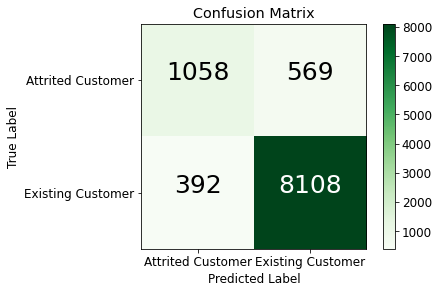

0.8856445000177676


,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,72.9655,65.0277,90.5105,0.687683
1,Existing Customer,93.4424,95.3882,90.5105,0.944053


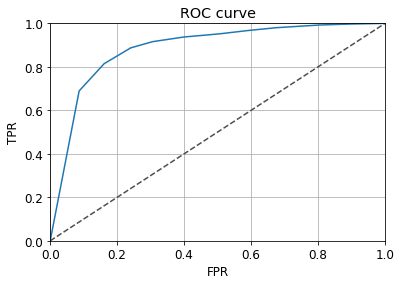

In [79]:
from sklearn.ensemble import GradientBoostingClassifier#GBDT
GBDT = KNeighborsClassifier(n_neighbors=10, p=2, metric='minkowski')
#p是度量范数，metric='minkowski'距离度量标准2范数
GBDT.fit(xtrain, ytrain)
print(GBDT.score(xtrain,ytrain))
print(GBDT.score(xtest,ytest))
cm=np.array(confusion_matrix(y,GBDT.predict(x)))
y_pred_quant=GBDT.predict_proba(xtest)[:,1]
print(cm)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_GBDT = np.round(100*TP/(TP+FP),4)  #精确率
Recall_GBDT = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_GBDT = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_GBDT = (np.round(2*Precision_GBDT*Recall_GBDT/(Precision_GBDT+Recall_GBDT),4)) #F1-score
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
draw_ROC(y_pred_quant)
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_GBDT,'recall':Recall_GBDT,'accuracy':Accuracy_GBDT,'F1-score':F1_GBDT/100}
df = pd.DataFrame(data0)
df

0.6614878209348255
0.6449447077409163
[[ 677  950]
 [2520 5980]]


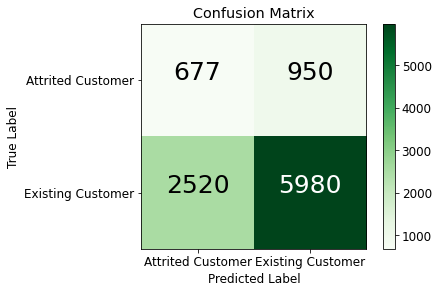

0.5438633799438541


,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,21.1761,41.6103,65.7352,0.280680
1,Existing Customer,86.2915,70.3529,65.7352,0.775113


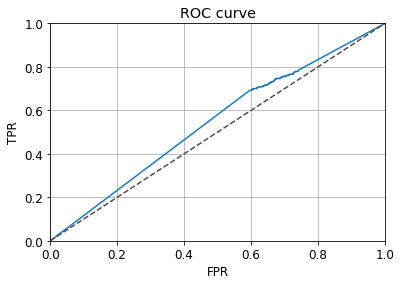

In [80]:
from sklearn.naive_bayes import MultinomialNB#朴素贝叶斯 多项式分布求概率
NB = MultinomialNB()
NB.fit(xtrain, ytrain)
print(NB.score(xtrain,ytrain))
print(NB.score(xtest,ytest))
cm=np.array(confusion_matrix(y,NB.predict(x)))
y_pred_quant=NB.predict_proba(xtest)[:,1]
print(cm)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_NB = np.round(100*TP/(TP+FP),4)  #精确率
Recall_NB = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_NB = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_NB = (np.round(2*Precision_NB*Recall_NB/(Precision_NB+Recall_NB),4)) #F1-score
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
draw_ROC(y_pred_quant)
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_NB,'recall':Recall_NB,'accuracy':Accuracy_NB,'F1-score':F1_NB/100}
df = pd.DataFrame(data0)
df

In [82]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as Data
from sklearn.model_selection import train_test_split
HIDDEN_UNITS = 20
LEARNING_RATE = 0.001  #0.001
EPOCH = 200      # best
BATCH_SIZE = 200
# Using 2 hidden layers  dnn网络
input_size = 19
num_classes = 2
class DNN(nn.Module):    #dnn网络
    def __init__(self, input_size, num_classes):
        super().__init__()
        self.fc1 = nn.Linear(input_size, 16)
        self.fc2 = nn.Linear(16, 8)
        self.fc3 = nn.Linear(8, num_classes)
    def forward(self, x):
        x = F.sigmoid(self.fc1(x))
        x = F.sigmoid(self.fc2(x))
        y_hat = self.fc3(x)
        return y_hat
#torch.nn.functional.tanh(input)
#torch.nn.functional.sigmoid(input)
#torch.nn.functional.relu(input, inplace=False)
def genarate_data(device):    #准备数据
    data=pd.read_csv('data.csv')
    trains, tests = train_test_split(data, test_size=0.2, random_state=4)
    trains_label=trains['Attrition_Flag'].values
    trains_data=trains.drop(['Attrition_Flag'],axis=1).values
    tests_label = tests['Attrition_Flag'].values
    tests_data = tests.drop(['Attrition_Flag'],axis=1).values
    tests_data = torch.Tensor(tests_data).to(device)
    tests_label = torch.LongTensor(tests_label).to(device)
    trains_data = torch.Tensor(trains_data).to(device)
    trains_label = torch.LongTensor(trains_label).to(device)
    return tests_data, tests_label, trains_data, trains_label,tests




In [83]:
#main()
# we want to use GPU if we have one
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
tests_data, tests_label, trains_data, trains_label,tests = genarate_data(device)
# prepare the data loader
training_set = Data.TensorDataset(trains_data,
                                      trains_label)
training_loader = Data.DataLoader(dataset=training_set,
                                      batch_size=BATCH_SIZE,
                                      shuffle=True)
testing_set = Data.TensorDataset(tests_data,
                                     tests_label)
testing_loader = Data.DataLoader(dataset=testing_set,
                                     batch_size=BATCH_SIZE,
                                     shuffle=False)
model = DNN(input_size, num_classes).to(device)
# using crossentropy loss on classification problem
criterion = nn.CrossEntropyLoss()
optim = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
for epoch in range(EPOCH):
    correct_train = 0
    total_train = 0
    for (data, label) in training_loader:
        pred_label = model(data)
        loss = criterion(pred_label, label)
        optim.zero_grad()
        loss.backward()
        optim.step()
        _, answer = torch.max(pred_label.data, 1)
        total_train += label.size(0)
        correct_train += (answer == label).sum()
    print('Epoch {:3d} Accuracy on training data: {}% ({}/{})'
              .format(epoch, (100 * correct_train / total_train), correct_train, total_train))
# pytorch 0.4 feature, not calculate grad on test set
    with torch.no_grad():
        correct_test = 0
        total_test = 0
        for (data, label) in testing_loader:
            pred_label = model(data)
            _, answer = torch.max(pred_label.data, 1)
            total_test += label.size(0)
            correct_test += (answer == label).sum()
        print('          Accuracy on testing data: {}% ({}/{})'
                  .format((100 * correct_test / total_test), correct_test, total_test))
with torch.no_grad():
    predict = []
    label1 = []
    for (data, label) in testing_loader:
        pred_label = model(data)
        _, answer = torch.max(pred_label.data, 1)
        predict.append(answer.data.cpu().numpy().tolist())
        label1.append(label.data.cpu().numpy().tolist())
    predict = [i for j in predict for i in j]
    label1 = [i for j in label1 for i in j]
    ct = pd.DataFrame({'predict': predict, 'real': label1})
    tests=tests.reset_index(drop=True)
#     inverted = label_encoder.inverse_transform(tests['Attrition_Flag'].values)
#     tests['Attrition_Flag']=inverted
    final=pd.concat([tests,ct],axis=1)
    final.to_csv("final.csv", index=False,encoding = "GB2312")


Epoch   0 Accuracy on training data: 83.81681823730469% (6790/8101)
          Accuracy on testing data: 84.40277099609375% (1710/2026)
Epoch   1 Accuracy on training data: 83.81681823730469% (6790/8101)
          Accuracy on testing data: 84.40277099609375% (1710/2026)
Epoch   2 Accuracy on training data: 83.81681823730469% (6790/8101)
          Accuracy on testing data: 84.40277099609375% (1710/2026)
Epoch   3 Accuracy on training data: 83.81681823730469% (6790/8101)
          Accuracy on testing data: 84.40277099609375% (1710/2026)
Epoch   4 Accuracy on training data: 83.81681823730469% (6790/8101)
          Accuracy on testing data: 84.40277099609375% (1710/2026)
Epoch   5 Accuracy on training data: 83.81681823730469% (6790/8101)
          Accuracy on testing data: 84.40277099609375% (1710/2026)
Epoch   6 Accuracy on training data: 83.81681823730469% (6790/8101)
          Accuracy on testing data: 84.40277099609375% (1710/2026)
Epoch   7 Accuracy on training data: 83.81681823730469%

Epoch  61 Accuracy on training data: 84.9030990600586% (6878/8101)
          Accuracy on testing data: 85.29122161865234% (1728/2026)
Epoch  62 Accuracy on training data: 84.59449768066406% (6853/8101)
          Accuracy on testing data: 85.38993835449219% (1730/2026)
Epoch  63 Accuracy on training data: 84.97716522216797% (6884/8101)
          Accuracy on testing data: 84.84699249267578% (1719/2026)
Epoch  64 Accuracy on training data: 84.44636535644531% (6841/8101)
          Accuracy on testing data: 84.6495590209961% (1715/2026)
Epoch  65 Accuracy on training data: 83.97728729248047% (6803/8101)
          Accuracy on testing data: 84.55084228515625% (1713/2026)
Epoch  66 Accuracy on training data: 84.70559692382812% (6862/8101)
          Accuracy on testing data: 85.09378814697266% (1724/2026)
Epoch  67 Accuracy on training data: 84.74263000488281% (6865/8101)
          Accuracy on testing data: 85.04442596435547% (1723/2026)
Epoch  68 Accuracy on training data: 85.13764190673828% (

Epoch 123 Accuracy on training data: 85.01419830322266% (6887/8101)
          Accuracy on testing data: 85.38993835449219% (1730/2026)
Epoch 124 Accuracy on training data: 85.21170806884766% (6903/8101)
          Accuracy on testing data: 84.74827575683594% (1717/2026)
Epoch 125 Accuracy on training data: 84.98950958251953% (6885/8101)
          Accuracy on testing data: 84.60020446777344% (1714/2026)
Epoch 126 Accuracy on training data: 85.21170806884766% (6903/8101)
          Accuracy on testing data: 85.48865509033203% (1732/2026)
Epoch 127 Accuracy on training data: 85.52030944824219% (6928/8101)
          Accuracy on testing data: 85.78480529785156% (1738/2026)
Epoch 128 Accuracy on training data: 85.32279968261719% (6912/8101)
          Accuracy on testing data: 85.1925048828125% (1726/2026)
Epoch 129 Accuracy on training data: 85.18701934814453% (6901/8101)
          Accuracy on testing data: 85.43929290771484% (1731/2026)
Epoch 130 Accuracy on training data: 85.43389892578125% 

Epoch 185 Accuracy on training data: 86.54487609863281% (7011/8101)
          Accuracy on testing data: 86.17967224121094% (1746/2026)
Epoch 186 Accuracy on training data: 86.63127899169922% (7018/8101)
          Accuracy on testing data: 86.82132720947266% (1759/2026)
Epoch 187 Accuracy on training data: 86.9645767211914% (7045/8101)
          Accuracy on testing data: 87.01876068115234% (1763/2026)
Epoch 188 Accuracy on training data: 86.74237823486328% (7027/8101)
          Accuracy on testing data: 86.52517700195312% (1753/2026)
Epoch 189 Accuracy on training data: 86.55722045898438% (7012/8101)
          Accuracy on testing data: 87.11747741699219% (1765/2026)
Epoch 190 Accuracy on training data: 87.0016098022461% (7048/8101)
          Accuracy on testing data: 87.16683959960938% (1766/2026)
Epoch 191 Accuracy on training data: 85.69313049316406% (6942/8101)
          Accuracy on testing data: 84.15597534179688% (1705/2026)
Epoch 192 Accuracy on training data: 85.92766571044922% (

[[  97  219]
 [  42 1668]]


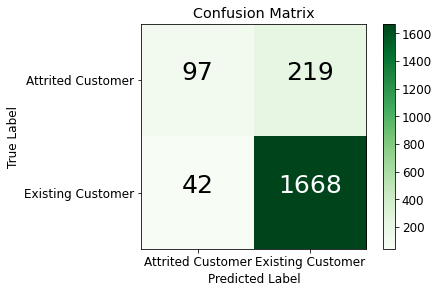

,Attrition_Flag,prediction,recall,accuracy,F1-score
0,Attrited Customer,69.7842,30.6962,87.1175,0.426374
1,Existing Customer,88.3943,97.5439,87.1175,0.927440


In [84]:
#混淆矩阵
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
y_true=final['real'].values
y_pred=final['predict'].values
cm=confusion_matrix(y_true, y_pred)
FP = cm.sum(axis=0) - np.diag(cm)   #假正例
FN = cm.sum(axis=1) - np.diag(cm)   #假负例
TP = np.diag(cm)                    #真正例
TN = cm.sum() - (FP + FN + TP)      #真负例
Precision_dnn = np.round(100*TP/(TP+FP),4)  #精确率
Recall_dnn = np.round(100*TP/(TP+FN),4)  #召回率
Accuracy_dnn = np.round(100*(TP+TN)/(TP+TN+FP+FN),4) #准确率
F1_dnn = (np.round(2*Precision_dnn*Recall_dnn/(Precision_dnn+Recall_dnn),4)) #F1-score
print(cm)
cnf_matrix_plotter(cm,['Attrited Customer','Existing Customer'])
data0 = {'Attrition_Flag':['Attrited Customer','Existing Customer'], 'prediction':Precision_dnn,'recall':Recall_dnn,'accuracy':Accuracy_dnn,'F1-score':F1_dnn/100}
df = pd.DataFrame(data0)
df



In [85]:
data_Attrited_Customer = {'classifier':['RandomForestClassifier','Perceptron','LogisticRegression','SVC','DecisionTreeClassifier',
                       'KNeighborsClassifier','GBDT','MultinomialNB','DNN'], 
         'prediction':[Precision_rfc[0],Precision_ppn[0],Precision_lr[0],Precision_svm[0],Precision_tree[0]
                      ,Precision_knn[0],Precision_GBDT[0],Precision_NB[0],Precision_dnn[0]],
         'recall':[Recall_rfc[0],Recall_ppn[0],Recall_lr[0],Recall_svm[0],Recall_tree[0]
                      ,Recall_knn[0],Recall_GBDT[0],Recall_NB[0],Recall_dnn[0]],
         'accuracy':[Accuracy_rfc[0],Accuracy_ppn[0],Accuracy_lr[0],Accuracy_svm[0],Accuracy_tree[0]
                      ,Accuracy_knn[0],Accuracy_GBDT[0],Accuracy_NB[0],Accuracy_dnn[0]],
         'F1-score':[F1_rfc[0],F1_ppn[0],F1_lr[0],F1_svm[0],F1_tree[0]
                      ,F1_knn[0],F1_GBDT[0],F1_NB[0],F1_dnn[0]]}
df0 = pd.DataFrame(data_Attrited_Customer)
df0

,classifier,prediction,recall,accuracy,F1-score
0,RandomForestClassifier,97.8630,95.6976,98.9730,96.7682
1,Perceptron,NaN,0.0000,83.9340,NaN
2,LogisticRegression,79.3478,40.3811,88.7331,53.5234
3,SVC,100.0000,73.6939,95.7737,84.8549
4,DecisionTreeClassifier,94.2543,94.7757,98.2324,94.5143
5,KNeighborsClassifier,72.9655,65.0277,90.5105,68.7683
6,GBDT,72.9655,65.0277,90.5105,68.7683
7,MultinomialNB,21.1761,41.6103,65.7352,28.0680
8,DNN,69.7842,30.6962,87.1175,42.6374


Text(0.5, 1.0, 'Attrited Customer')

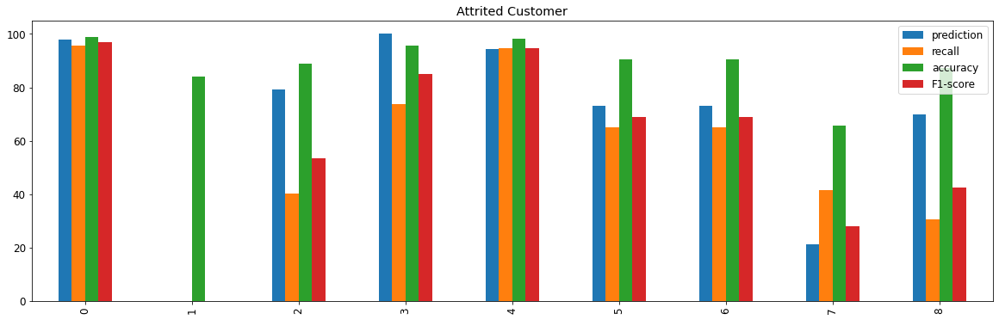

In [86]:
df0.plot(kind="bar",figsize=(20,6))
plt.title("Attrited Customer")

In [87]:
data_Existing_Customer = {'classifier':['RandomForestClassifier','Perceptron','LogisticRegression','SVC','DecisionTreeClassifier',
                       'KNeighborsClassifier','GBDT','MultinomialNB','DNN'], 
         'prediction':[Precision_rfc[1],Precision_ppn[1],Precision_lr[1],Precision_svm[1],Precision_tree[1]
                      ,Precision_knn[1],Precision_GBDT[1],Precision_NB[1],Precision_dnn[1]],
         'recall':[Recall_rfc[1],Recall_ppn[1],Recall_lr[1],Recall_svm[1],Recall_tree[1]
                      ,Recall_knn[1],Recall_GBDT[1],Recall_NB[1],Recall_dnn[1]],
         'accuracy':[Accuracy_rfc[1],Accuracy_ppn[1],Accuracy_lr[1],Accuracy_svm[1],Accuracy_tree[1]
                      ,Accuracy_knn[1],Accuracy_GBDT[1],Accuracy_NB[1],Accuracy_dnn[1]],
         'F1-score':[F1_rfc[1],F1_ppn[1],F1_lr[1],F1_svm[1],F1_tree[1]
                      ,F1_knn[1],F1_GBDT[1],F1_NB[1],F1_dnn[1]]}
df1 = pd.DataFrame(data_Existing_Customer)
df1

,classifier,prediction,recall,accuracy,F1-score
0,RandomForestClassifier,99.1799,99.6000,98.9730,99.3895
1,Perceptron,83.9340,100.0000,83.9340,91.2653
2,LogisticRegression,89.5688,97.9882,88.7331,93.5895
3,SVC,95.2061,100.0000,95.7737,97.5442
4,DecisionTreeClassifier,98.9989,98.8941,98.2324,98.9465
5,KNeighborsClassifier,93.4424,95.3882,90.5105,94.4053
6,GBDT,93.4424,95.3882,90.5105,94.4053
7,MultinomialNB,86.2915,70.3529,65.7352,77.5113
8,DNN,88.3943,97.5439,87.1175,92.7440


Text(0.5, 1.0, 'Existing Customer')

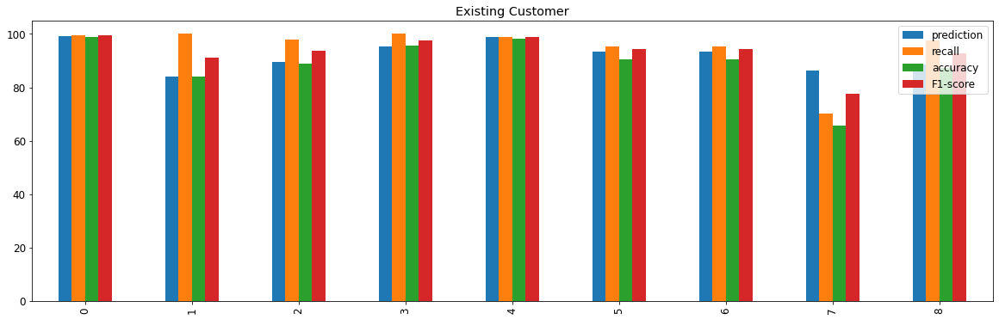

In [88]:
df1.plot(kind="bar",figsize=(20,6))
plt.title("Existing Customer")

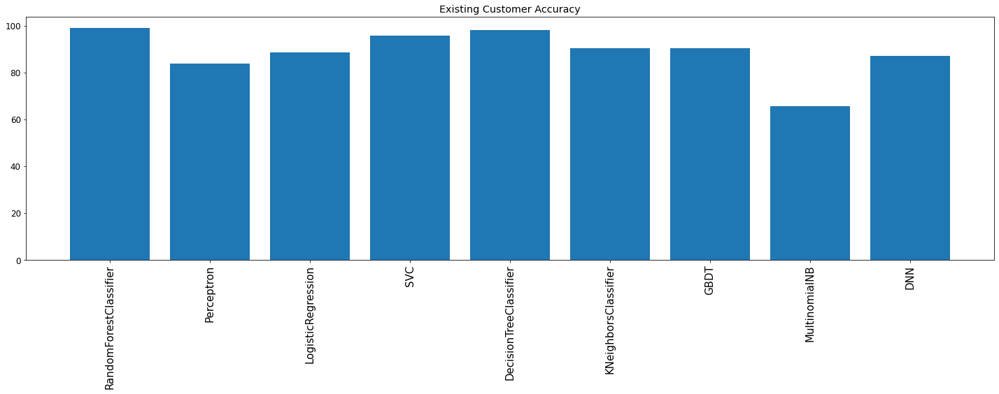

In [89]:
# df1.iloc[:,1].plot(kind="bar",figsize=(20,6))
name_list=['RandomForestClassifier','Perceptron','LogisticRegression','SVC','DecisionTreeClassifier',
                       'KNeighborsClassifier','GBDT','MultinomialNB','DNN']
f, ax = plt.subplots(figsize=(20, 8))
# ax.bar(range(len(rfc.feature_importances_)),rfc.feature_importances_,tick_label=name_list)
ax.bar(range(len(df1.iloc[:,3])),df1.iloc[:,3],tick_label=name_list)
ax.set_xticklabels(name_list,fontsize=15,rotation=90)
ax.set_title("Existing Customer Accuracy")
f.show()
f.tight_layout()
# plt.ylabel('True Label')
# plt.xlabel('Predicted Label')  
# plt.show()